In [1]:
import os
os.chdir("../")

# Set R environment variables using the conda environment path
r_home = '/sfs/gpfs/tardis/home/jq2uw/llm_nicu_vitalsigns/clip_env/lib/R'
os.environ['R_HOME'] = r_home
os.environ['R_LIBS'] = f"{r_home}/library"
os.environ['R_LIBS_USER'] = os.path.expanduser('~/R/goolf/4.3')
os.environ['LD_LIBRARY_PATH'] = f"{r_home}/lib:" + os.environ.get('LD_LIBRARY_PATH', '')

import torch
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    torch.cuda.ipc_collect()

In [2]:
from config import *
from data import *
from train import *
from eval import *
from generation import *
from vital2d import *
print("using device: ", device)

Random seed set to 333
using device:  cuda


## Customize Configuration

In [3]:
# (customize) configs
overwrite = True
model_name = 'test_ts_desc256' 
text_config['cl']['die7d'] = True # udpate text_config here if needed
# model_name = model_name + "___" + "_".join(get_true_components(text_config))

update_config(
    
    # y_col = 'description_succ_inc',
    # y_levels = ['High amount of consecutive increases.', 'Low amount of consecutive increases.'],
    # y_pred_levels = ['High amount of consecutive increases.', 'Low amount of consecutive increases.'],
    # txt2ts_y_cols = ['description_succ_inc', 'description_histogram', 'description_succ_unc'],
    
    y_col = 'description_succ_unc',
    y_levels = ['Many flat lines.', 'Few flat lines.'],
    y_pred_levels = ['Many flat lines.', 'Few flat lines.'],
    txt2ts_y_cols = ['description_succ_unc'],
    
    text_col = 'ts_description',
    downsample = True,
    downsample_size = 10000,
    downsample_levels = ['Many flat lines.', 'Few flat lines.'],
    custom_target_cols = ['label'], # 'description_succ_inc', 'description_histogram', 'description_succ_unc', 
    model_name = model_name,
    concat_embeddings = False,
    clip_mu = True,
    variational = False,
    
    embedded_dim = 256,
    batch_size = 512, # Data loader settings
    patience = 100, # Training settings
    num_saves = 10,
    num_epochs = 10,
    init_lr = 5e-5,
    text_config = text_config,
    **{'3d': False}  # Add this line
)
config_dict = get_config_dict()


#  result saving directory
output_dir = './results/'+config_dict['model_name']
model_clip_path = output_dir+'/model_clip.pth' 
eval_clip_path = output_dir+'/evals_clip.pth'
model_path = output_dir+'/model.pth' 
eval_path = output_dir+'/evals.pth'
config_path = output_dir+'/config.pth'

In [4]:
# run preprocess.py to ready the data
with open('main_preprocess.py', 'r') as file:
    exec(file.read())



Sample of patients with positive labels:
VitalID
1018    8
5170    8
1835    8
2361    8
2791    8
dtype: int64


[Parallel(n_jobs=96)]: Using backend LokyBackend with 96 concurrent workers.
[Parallel(n_jobs=96)]: Done   8 tasks      | elapsed:    4.0s
[Parallel(n_jobs=96)]: Done 258 tasks      | elapsed:    4.4s
[Parallel(n_jobs=96)]: Done 1154 tasks      | elapsed:    5.2s
[Parallel(n_jobs=96)]: Done 4353 tasks      | elapsed:    8.6s
[Parallel(n_jobs=96)]: Done 8690 tasks      | elapsed:   12.0s
[Parallel(n_jobs=96)]: Done 13456 tasks      | elapsed:   15.3s
[Parallel(n_jobs=96)]: Done 19456 tasks      | elapsed:   17.5s
[Parallel(n_jobs=96)]: Done 26256 tasks      | elapsed:   20.0s
[Parallel(n_jobs=96)]: Done 33856 tasks      | elapsed:   22.6s
[Parallel(n_jobs=96)]: Done 42256 tasks      | elapsed:   25.5s
[Parallel(n_jobs=96)]: Done 51456 tasks      | elapsed:   28.3s
[Parallel(n_jobs=96)]: Done 61456 tasks      | elapsed:   31.8s
[Parallel(n_jobs=96)]: Done 65100 out of 65100 | elapsed:   33.2s finished


replace 'text' with:  ts_description
text
Moderate variability. A few outliers. Moderate amount of consecutive increases. Few flat lines.                       6142
High variability. A few outliers. Moderate amount of consecutive increases. Few flat lines.                           5386
Moderate variability. A few outliers. Moderate amount of consecutive increases. Moderate flat lines.                  4966
High variability. A few outliers. High amount of consecutive increases. Few flat lines.                               4604
Higher than the normal range. Moderate variability. Moderate amount of consecutive increases. Moderate flat lines.    3251
Name: count, dtype: int64

Sample of patients with positive labels:
TestID
508     8
707     8
1903    8
817     8
1414    7
dtype: int64


[Parallel(n_jobs=96)]: Using backend LokyBackend with 96 concurrent workers.
[Parallel(n_jobs=96)]: Done   8 tasks      | elapsed:    0.0s
[Parallel(n_jobs=96)]: Done 324 tasks      | elapsed:    0.3s
[Parallel(n_jobs=96)]: Done 1472 tasks      | elapsed:    0.8s
[Parallel(n_jobs=96)]: Done 4432 tasks      | elapsed:    1.7s
[Parallel(n_jobs=96)]: Done 8832 tasks      | elapsed:    3.1s
[Parallel(n_jobs=96)]: Done 14032 tasks      | elapsed:    4.7s
[Parallel(n_jobs=96)]: Done 20032 tasks      | elapsed:    6.5s
[Parallel(n_jobs=96)]: Done 26832 tasks      | elapsed:    8.7s
[Parallel(n_jobs=96)]: Done 34432 tasks      | elapsed:   11.0s
[Parallel(n_jobs=96)]: Done 42832 tasks      | elapsed:   13.6s
[Parallel(n_jobs=96)]: Done 52032 tasks      | elapsed:   16.6s
[Parallel(n_jobs=96)]: Done 60674 tasks      | elapsed:   19.3s
[Parallel(n_jobs=96)]: Done 61197 out of 61197 | elapsed:   19.8s finished


replace 'text' with:  ts_description
text
Higher than the normal range. Low variability. Low amount of consecutive increases. Many flat lines.              4690
Moderate variability. A few outliers. Moderate amount of consecutive increases. Moderate flat lines.              3130
Higher than the normal range. Moderate variability. Moderate amount of consecutive increases. Many flat lines.    3039
Moderate variability. A few outliers. Moderate amount of consecutive increases. Few flat lines.                   2685
High variability. A few outliers. High amount of consecutive increases. Moderate flat lines.                      2564
Name: count, dtype: int64
After downsampling:
description_succ_unc
Few flat lines.     10000
Many flat lines.     9334
Name: count, dtype: int64
After downsampling:
description_succ_unc
Many flat lines.    10000
Few flat lines.      6859
Name: count, dtype: int64


final distribution of text prediction
description_succ_unc
Few flat lines.     10000
Many flat li

/home/jq2uw/.local/lib/python3.11/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm, trange


### Customize VITAL Model

In [7]:
# overwrite = False
# customize model
if overwrite or not os.path.exists(model_path):    
    # check if ts_f_dim is already in the memory
    if 'ts_f_dim' not in locals():
        # just to get the dimension out
        if config_dict['3d']:
            ts_f_dim, tx_f_dim_ls, labels_dim = get_features3d(df_train.iloc[:1,:], config_dict, text_col_ls = config_dict['text_col_ls'])
        else:
            ts_f_dim, tx_f_dim, labels_dim = get_features(df_train.iloc[:1,:], config_dict)
    
    ts_encoder = None
    ts_decoder = None
    if config_dict['3d']:
        model = VITAL3D(
                    ts_dim=ts_f_dim.shape[1],
                    text_dim=tx_f_dim_ls[0].shape[1],
                    n_text=len(tx_f_dim_ls),
                    output_dim=config_dict['embedded_dim'],
                    ts_encoder=ts_encoder,
                    ts_decoder=ts_decoder,
                    clip_mu = config_dict['clip_mu'],
                    concat_embeddings = config_dict['concat_embeddings']
                )
    else:
        model = VITAL(
                    ts_dim=ts_f_dim.shape[1],
                    text_dim=tx_f_dim.shape[1],
                    output_dim=config_dict['embedded_dim'],
                    ts_encoder=ts_encoder,
                    ts_decoder=ts_decoder,
                    clip_mu = config_dict['clip_mu'],
                    concat_embeddings = config_dict['concat_embeddings']
                )
    update_config(model_init = model)
    config_dict = get_config_dict()
    

    
    train_eval_metrics_ts2txt_list = []
    test_eval_metrics_ts2txt_list = []
    train_eval_metrics_txt2ts_list = []
    test_eval_metrics_txt2ts_list = []
    train_losses = []
    test_losses = []

    
    # ------------------------- ready output directory -------------------------
    import shutil
    if os.path.exists(output_dir):
        shutil.rmtree(output_dir)
    os.makedirs(output_dir)
    config_dict['model_init'] = model
    torch.save(config_dict, config_path)
    # overwrite = False # reset overwrite to False
else:
    config_dict = torch.load(config_path, map_location=torch.device(device))
    model = config_dict['model_init']
    print(nn_summary(model))
    model.device = device

    

Layer (type:depth-idx)                        Param #
VITAL                                         1
├─TSVAEEncoder: 1-1                           --
│    └─LocalNorm: 2-1                         --
│    └─Sequential: 2-2                        --
│    │    └─MultiLSTMEncoder: 3-1             11,111,424
│    │    └─LayerNorm: 3-2                    512
│    │    └─Linear: 3-3                       131,584
│    │    └─LeakyReLU: 3-4                    --
│    │    └─LayerNorm: 3-5                    1,024
│    │    └─Linear: 3-6                       131,328
│    │    └─LeakyReLU: 3-7                    --
│    │    └─LayerNorm: 3-8                    512
│    └─Linear: 2-3                            65,792
│    └─Linear: 2-4                            65,792
├─TextEncoder: 1-2                            --
│    └─Sequential: 2-5                        --
│    │    └─Linear: 3-9                       393,728
│    │    └─ReLU: 3-10                        --
│    │    └─Linear: 3-11     

# train jointly

Epoch [1/100]
	Training Loss: 6.113502
	Testing Loss: 6.276314
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.889517
	Testing Loss: 6.068914
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.816022
	Testing Loss: 5.808167
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.790774
	Testing Loss: 5.788477
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.788103
	Testing Loss: 5.804311
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.780170
	Testing Loss: 5.816122
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.756130
	Testing Loss: 5.774341
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.771911
	Testing Loss: 5.770856
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.759820
	Testing Loss: 5.782551
	Learning Rate: 0.000100000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.747856
	Testing Loss: 5.750455
	Learning Rate: 0.0

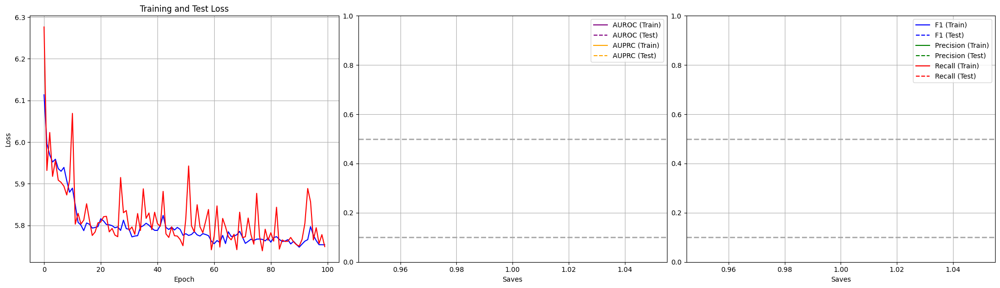

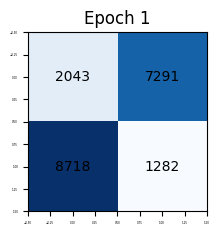

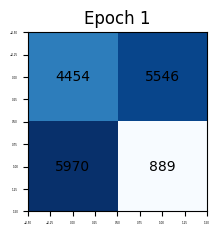

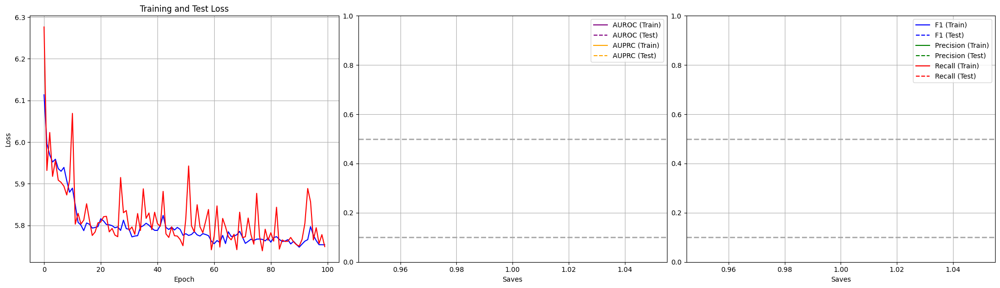

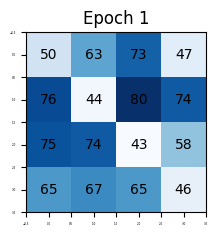

...

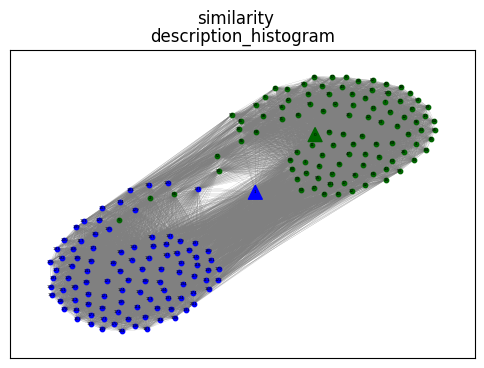

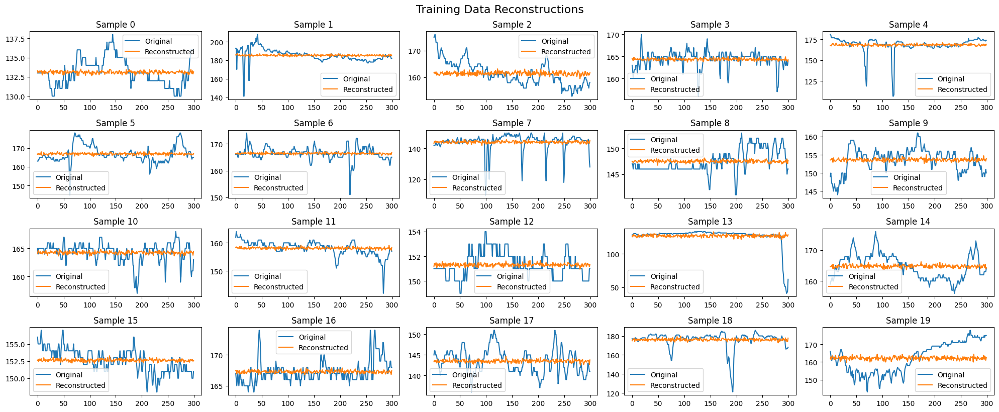

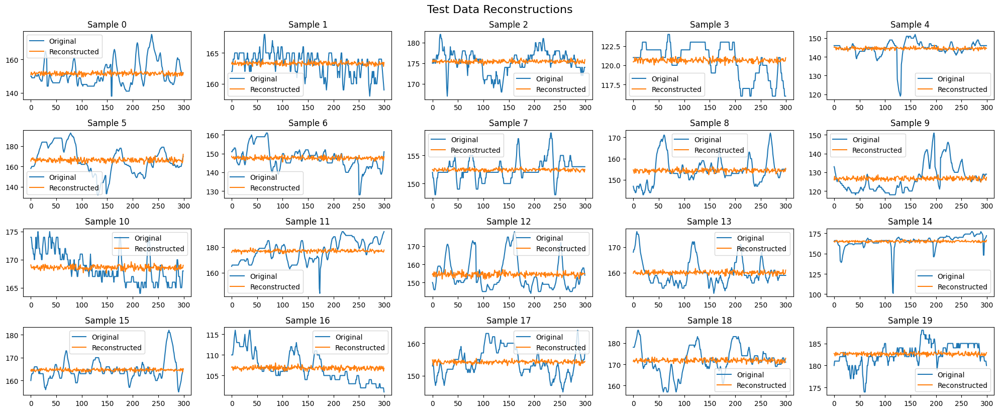

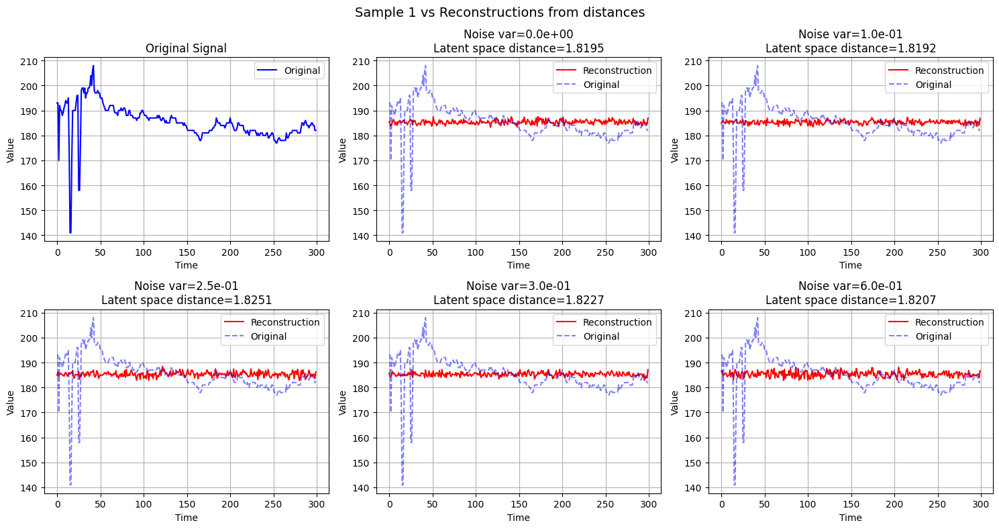

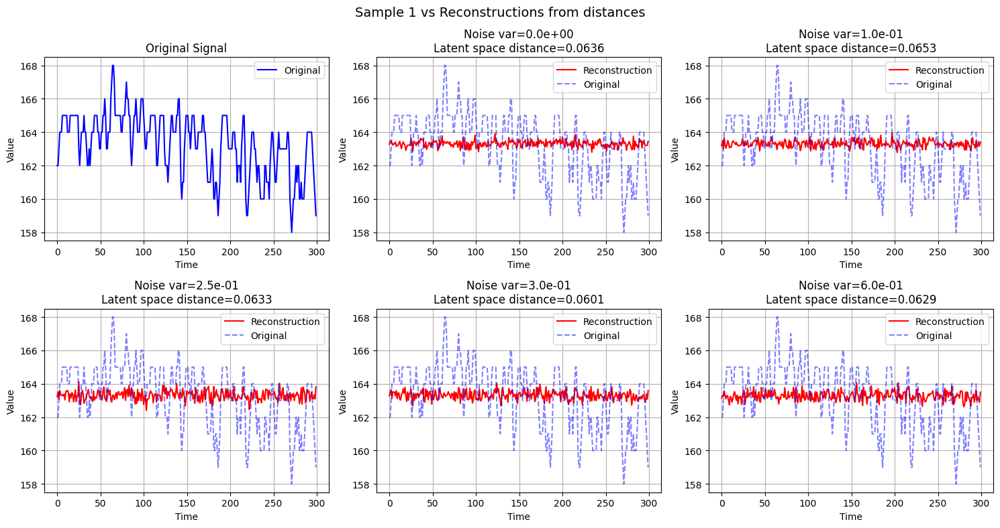

Epoch [1/100]
	Training Loss: 5.761587
	Testing Loss: 5.810842
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.759793
	Testing Loss: 5.769884
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.760385
	Testing Loss: 5.781380
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.757014
	Testing Loss: 5.770727
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.750123
	Testing Loss: 5.780375
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.752966
	Testing Loss: 5.858553
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.758192
	Testing Loss: 5.770434
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.755046
	Testing Loss: 5.782108
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.742415
	Testing Loss: 5.783999
	Learning Rate: 0.000100000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.745258
	Testing Loss: 5.795678
	Learning Rate: 0.0

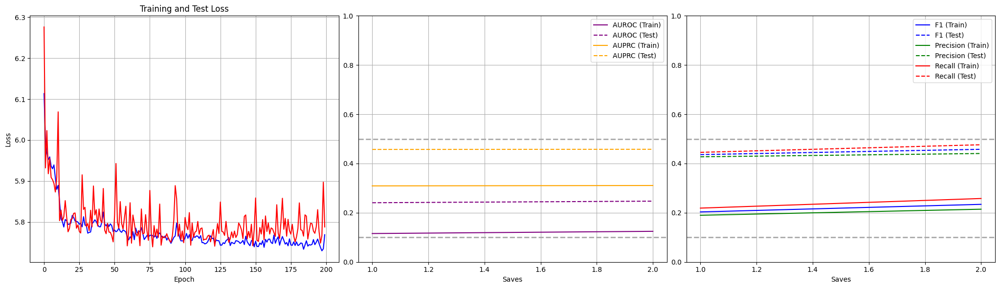

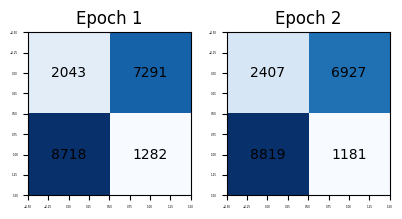

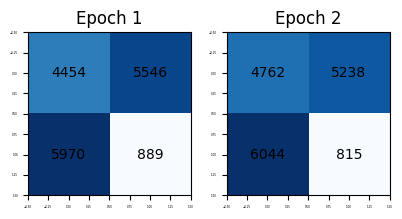

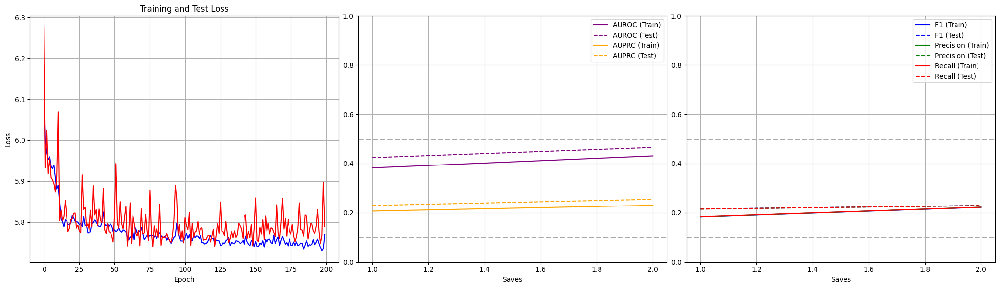

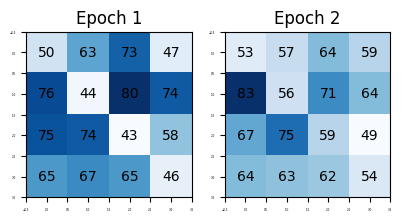

...

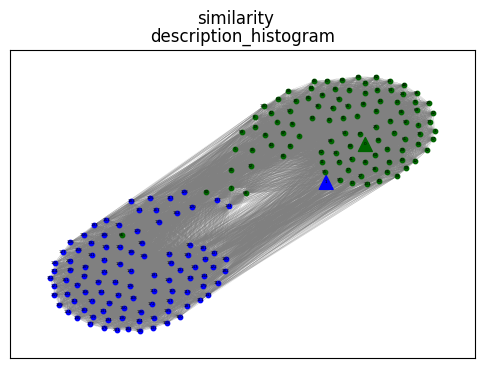

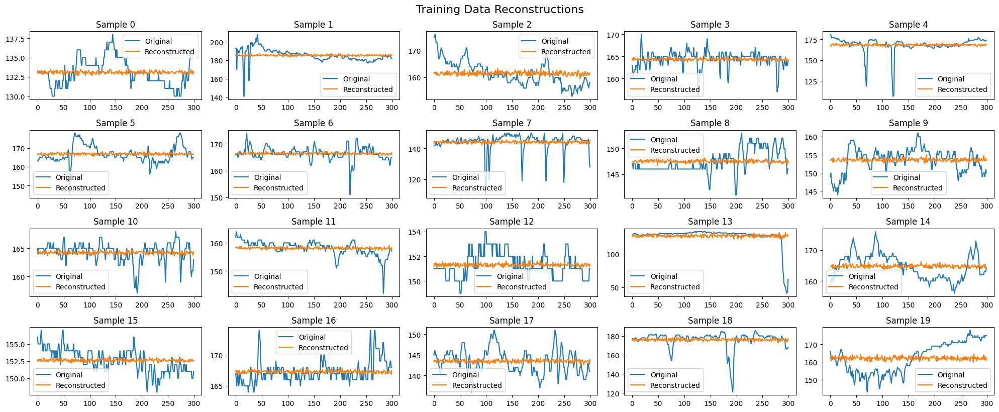

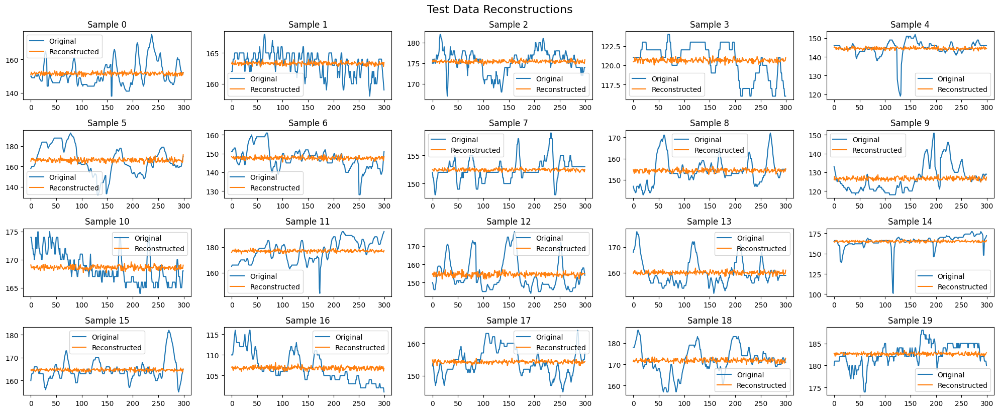

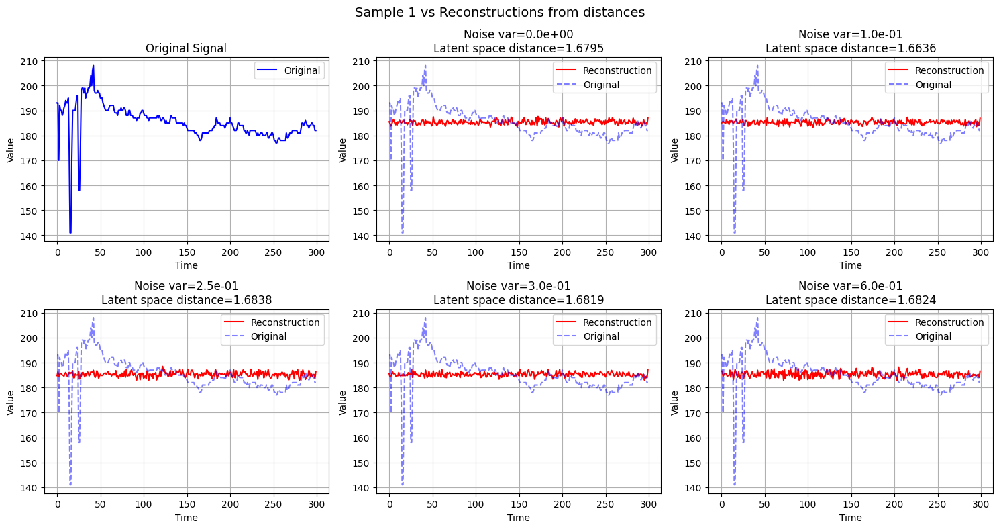

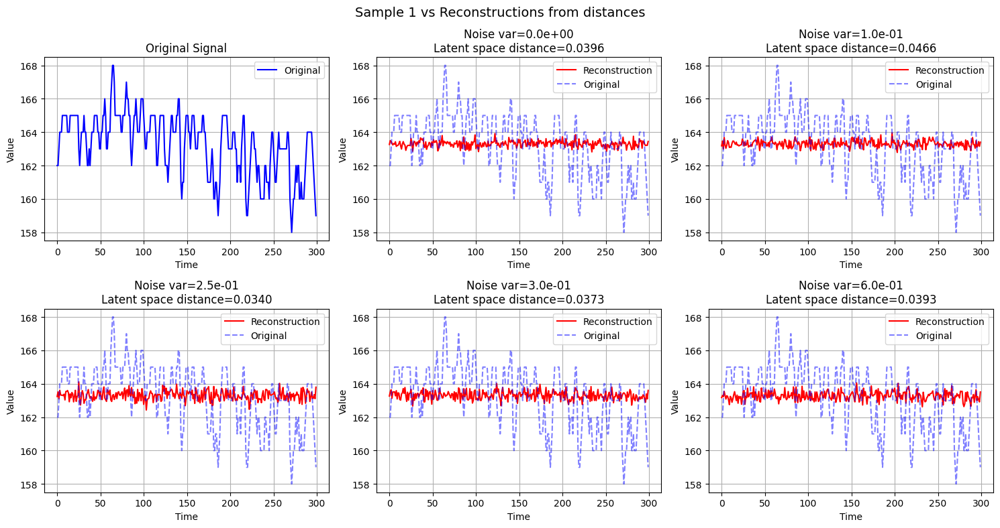

Epoch [1/100]
	Training Loss: 5.753407
	Testing Loss: 5.850174
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.745306
	Testing Loss: 5.761231
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.749190
	Testing Loss: 5.839808
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.744124
	Testing Loss: 5.799984
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.745701
	Testing Loss: 5.829042
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.742192
	Testing Loss: 5.870925
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.742432
	Testing Loss: 5.797986
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.751023
	Testing Loss: 5.829716
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.741838
	Testing Loss: 5.796600
	Learning Rate: 0.000100000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.744047
	Testing Loss: 5.815347
	Learning Rate: 0.0

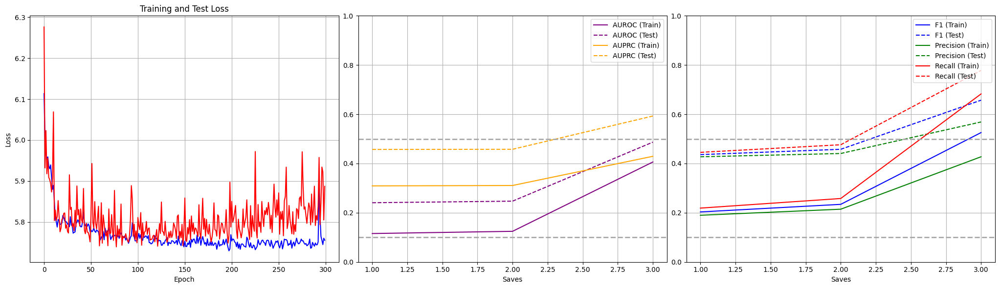

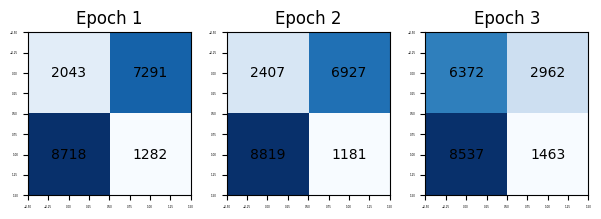

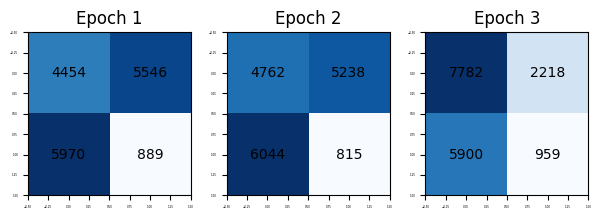

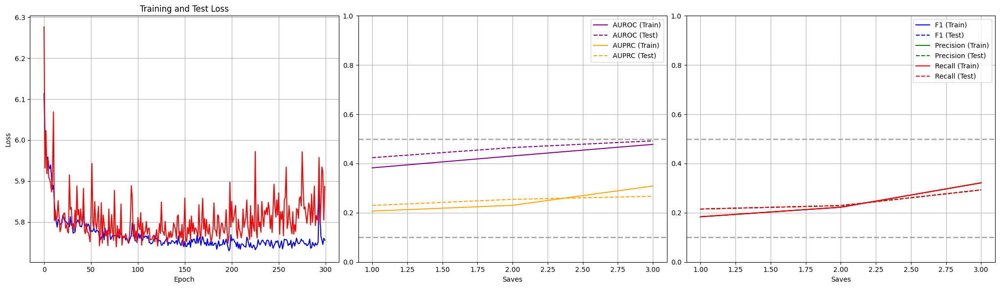

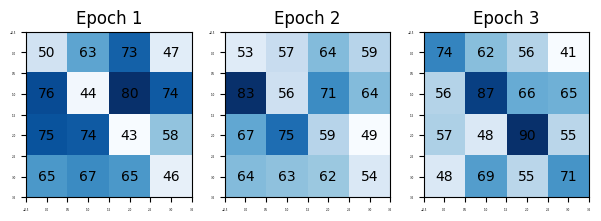

...

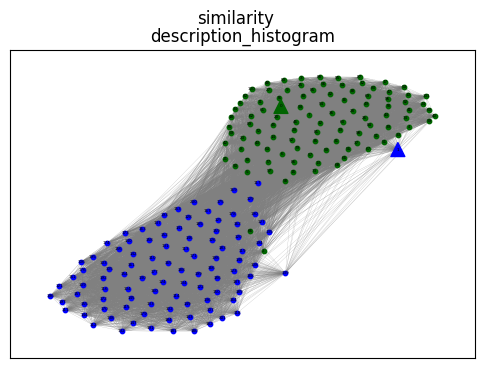

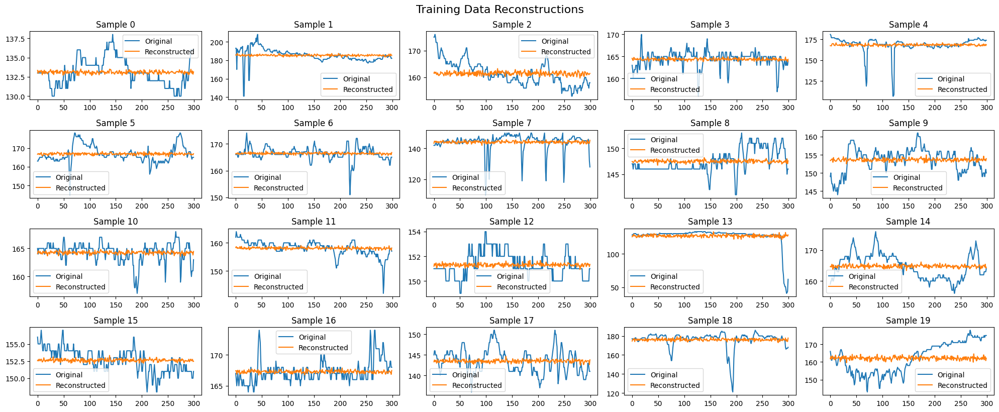

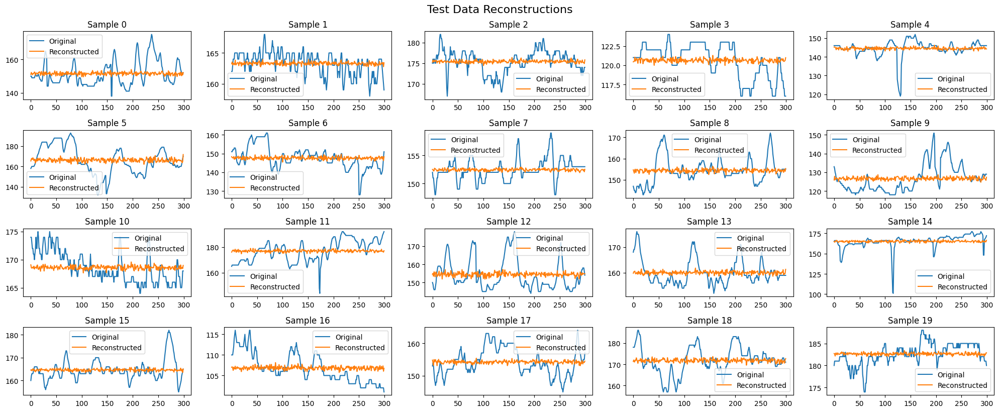

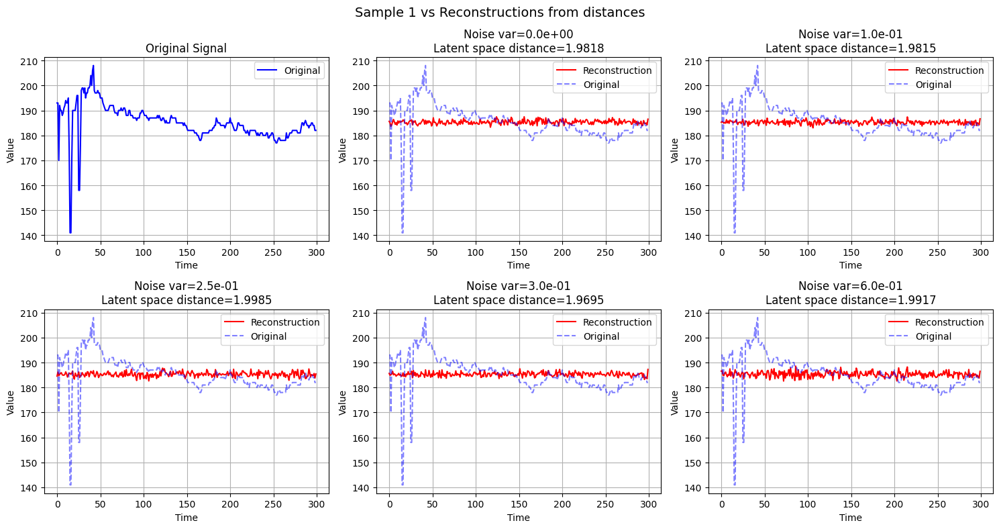

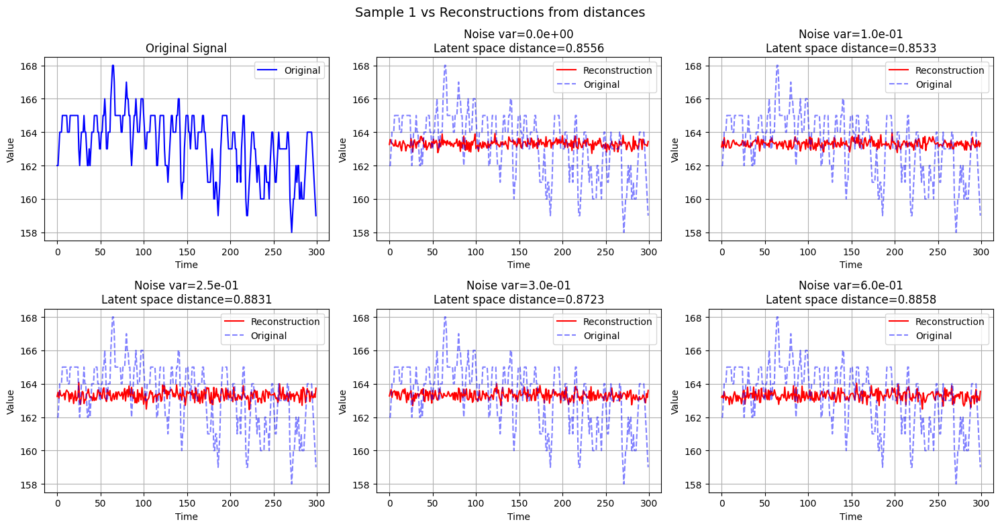

Epoch [1/100]
	Training Loss: 5.757376
	Testing Loss: 5.962174
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.756778
	Testing Loss: 5.788861
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.748681
	Testing Loss: 5.837315
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.737663
	Testing Loss: 5.817462
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.747612
	Testing Loss: 5.838552
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.746144
	Testing Loss: 5.802405
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.755414
	Testing Loss: 5.803058
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.762100
	Testing Loss: 5.816483
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.745514
	Testing Loss: 5.839821
	Learning Rate: 0.000100000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.725723
	Testing Loss: 5.803974
	Learning Rate: 0.0

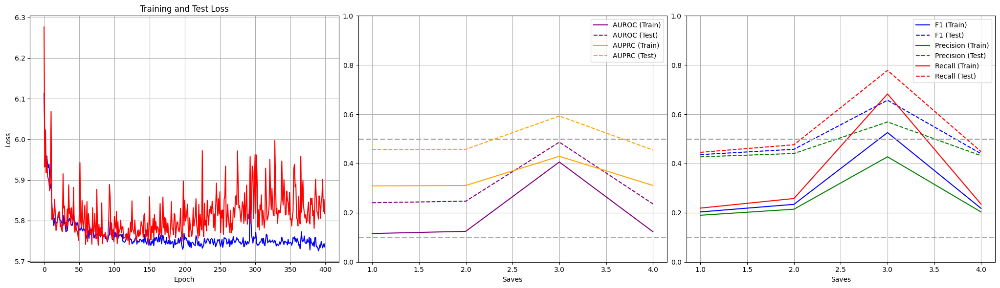

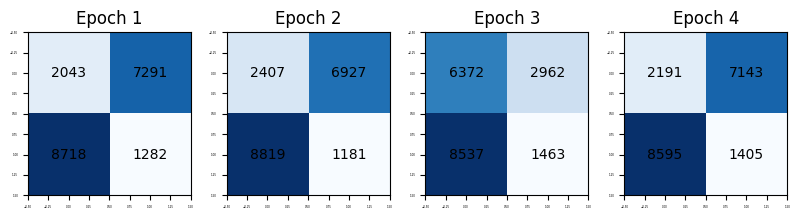

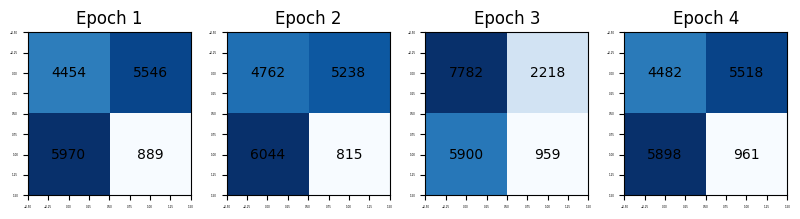

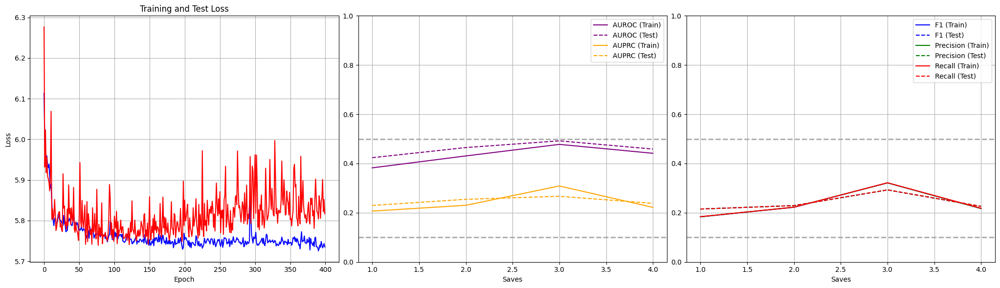

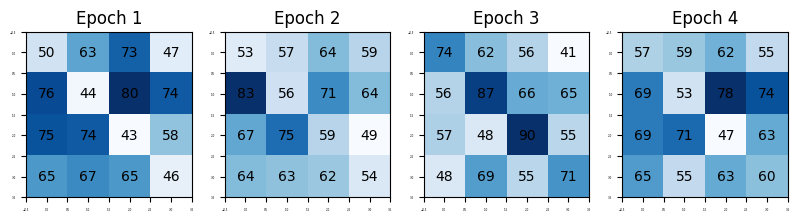

...

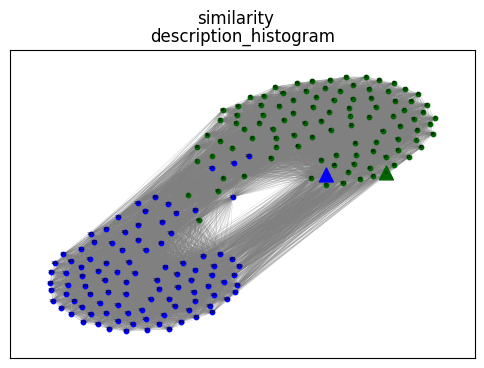

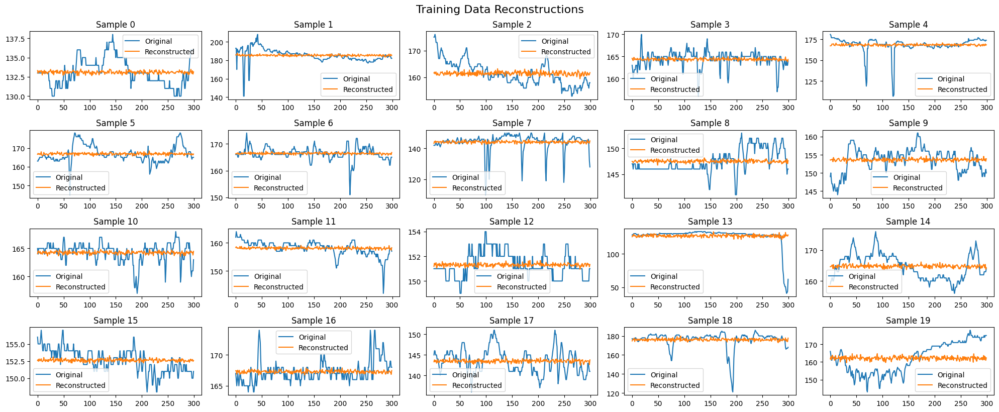

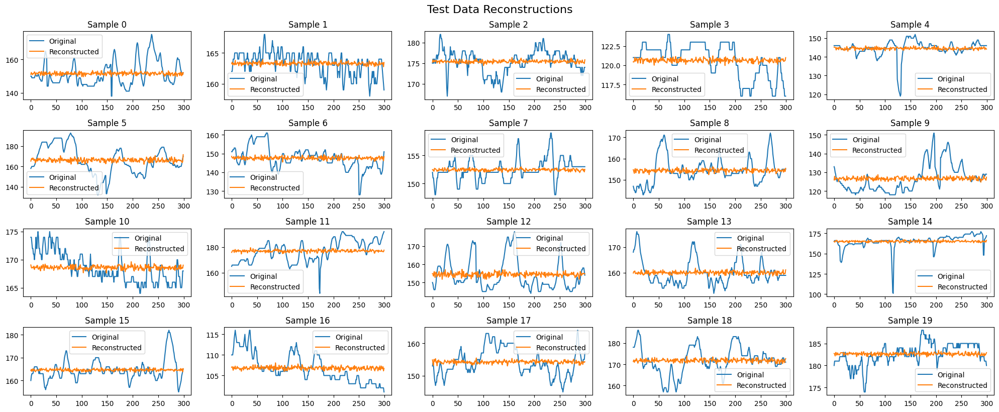

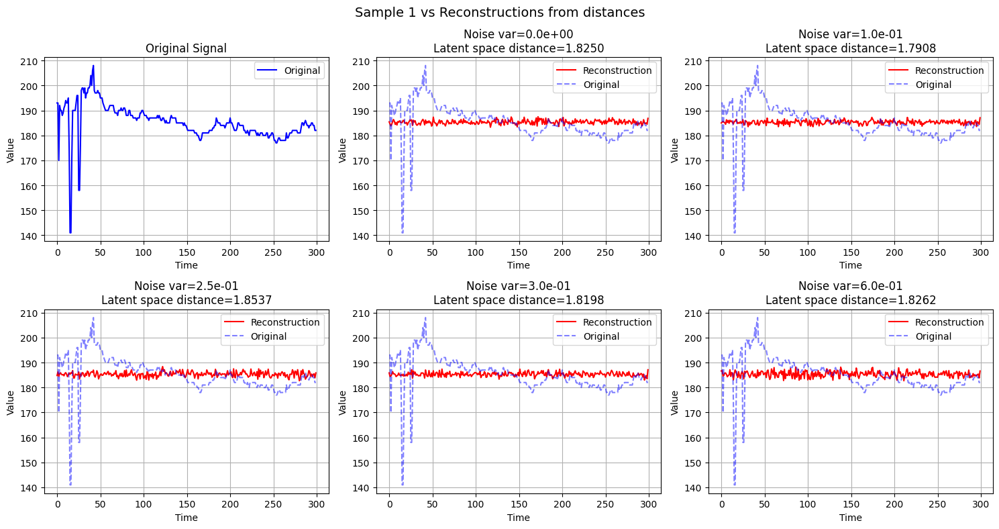

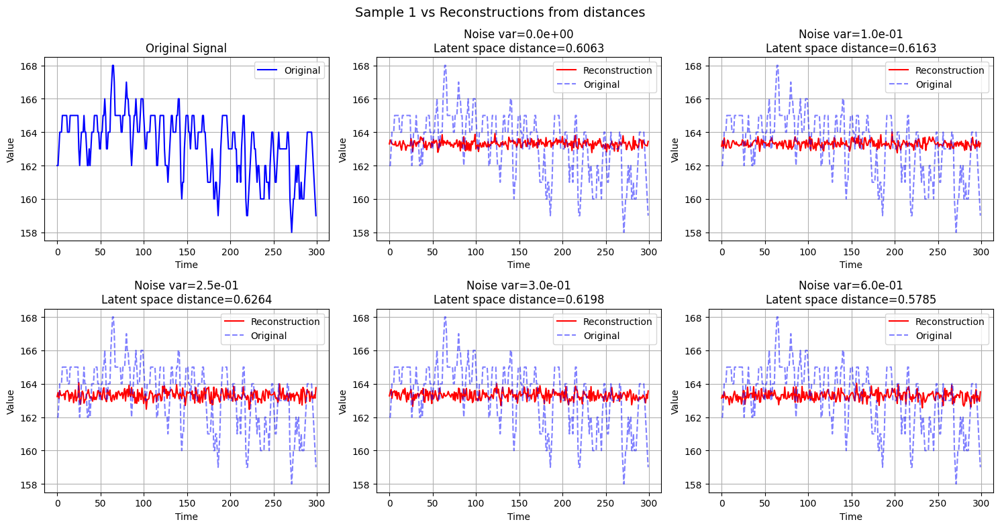

Epoch [1/100]
	Training Loss: 5.738079
	Testing Loss: 5.879758
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.731810
	Testing Loss: 5.787598
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.734529
	Testing Loss: 5.857773
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.735391
	Testing Loss: 5.885166
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.729913
	Testing Loss: 5.848616
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.731088
	Testing Loss: 5.814080
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.729154
	Testing Loss: 5.821838
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.725381
	Testing Loss: 5.821289
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.726039
	Testing Loss: 5.862839
	Learning Rate: 0.000100000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.711985
	Testing Loss: 5.791647
	Learning Rate: 0.0

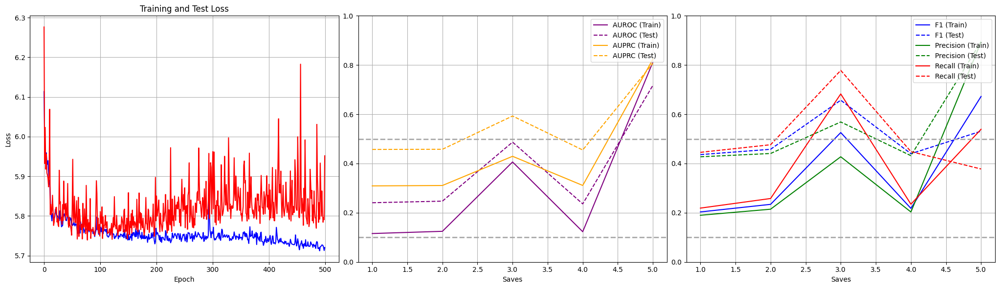

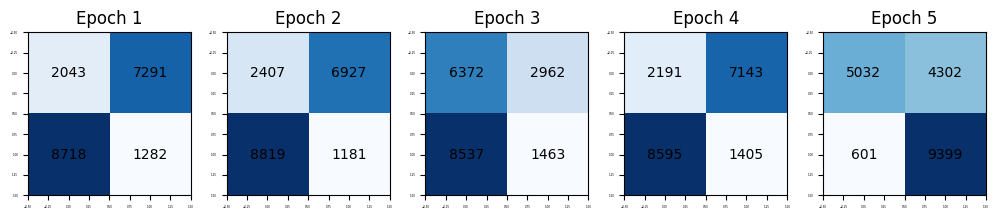

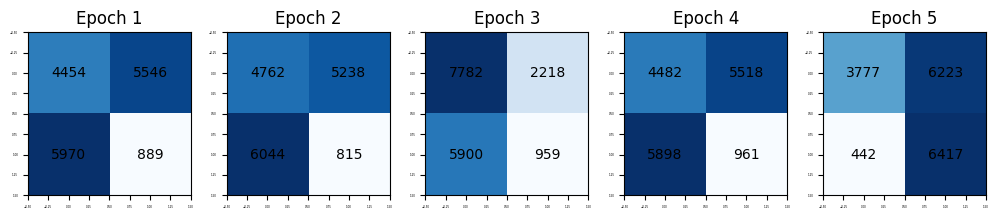

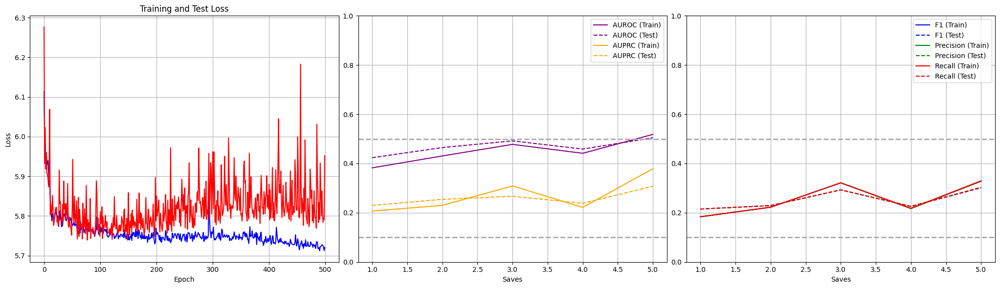

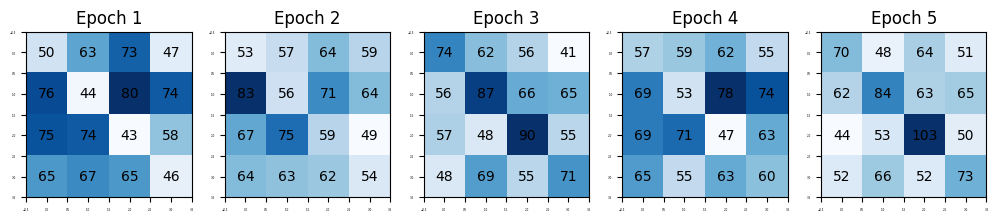

...

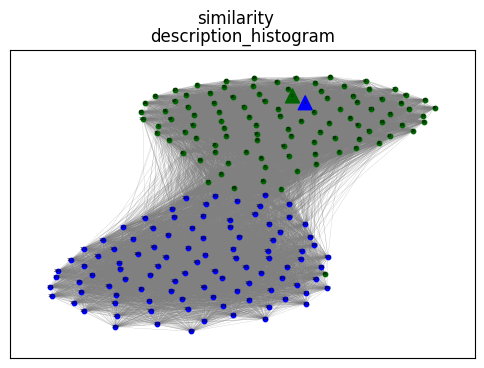

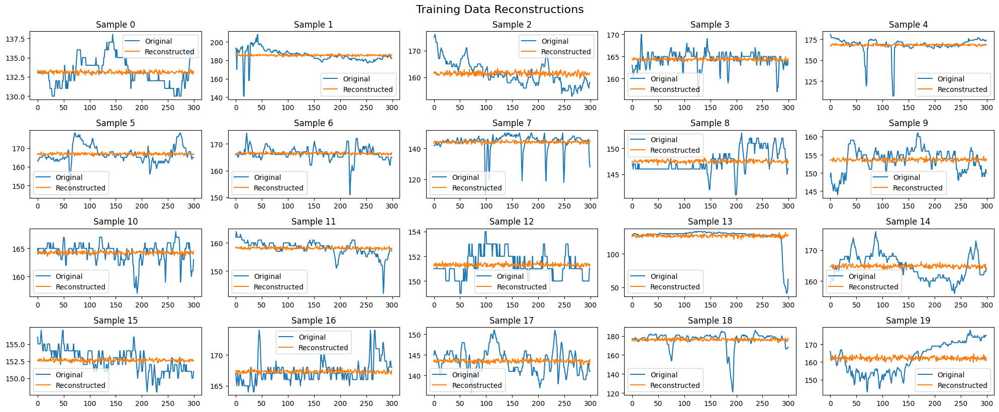

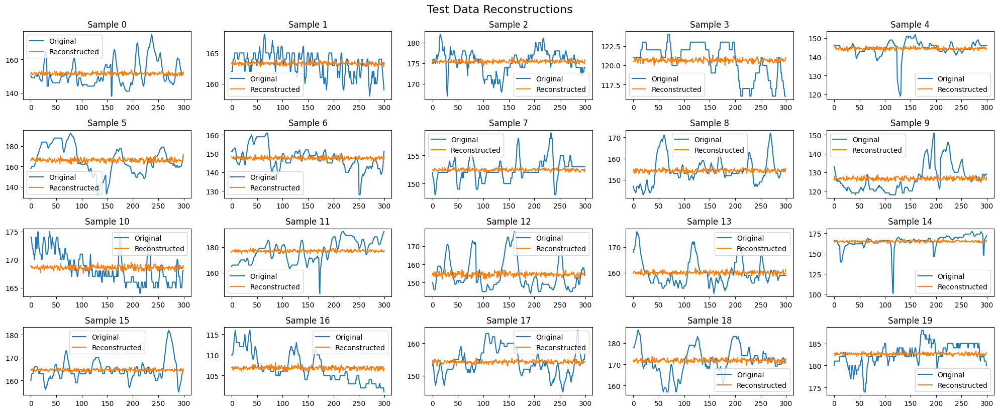

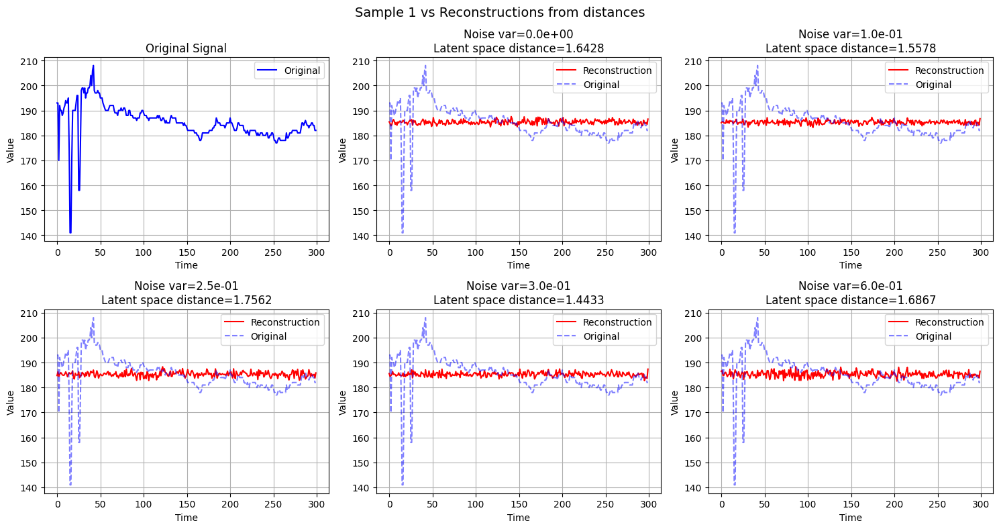

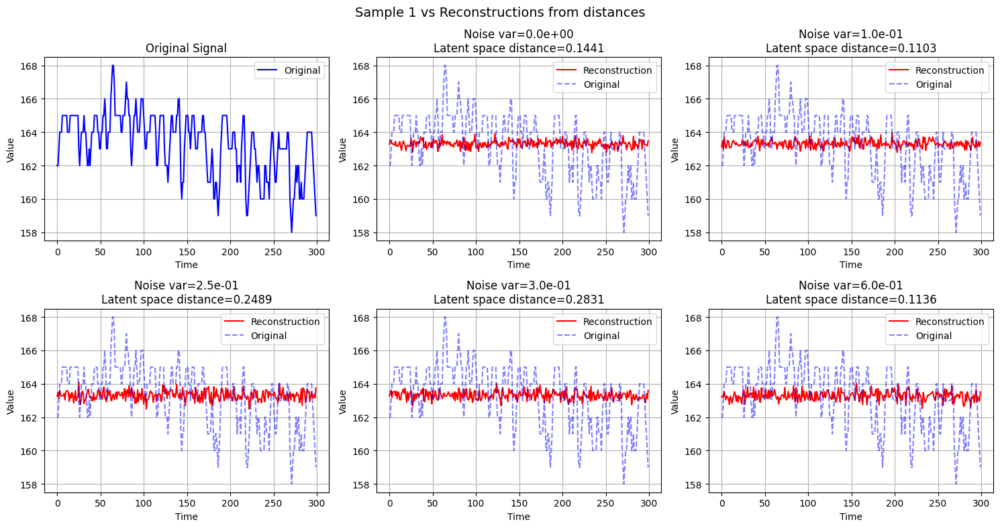

Epoch [1/100]
	Training Loss: 5.723190
	Testing Loss: 5.819131
	Learning Rate: 0.000100000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.726034
	Testing Loss: 5.934102
	Learning Rate: 0.000100000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.733777
	Testing Loss: 5.833975
	Learning Rate: 0.000100000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.725768
	Testing Loss: 5.768829
	Learning Rate: 0.000100000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.718652
	Testing Loss: 5.905466
	Learning Rate: 0.000100000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.724777
	Testing Loss: 5.825150
	Learning Rate: 0.000100000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.729227
	Testing Loss: 5.840081
	Learning Rate: 0.000100000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.734477
	Testing Loss: 5.804194
	Learning Rate: 0.000100000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.734564
	Testing Loss: 5.842309
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.736271
	Testing Loss: 5.818839
	Learning Rate: 0.0

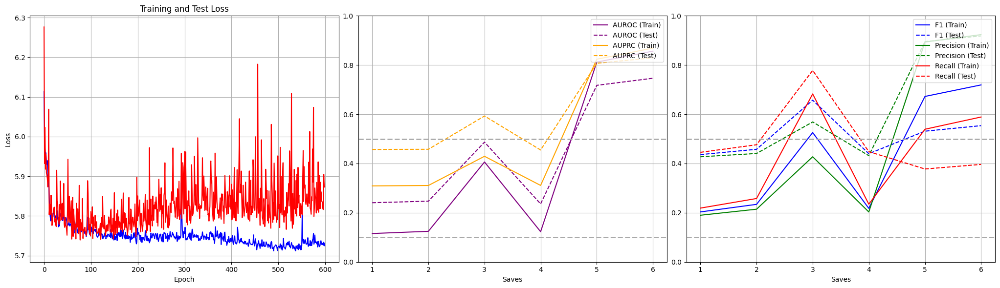

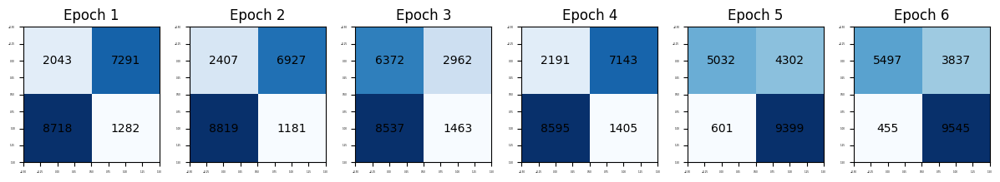

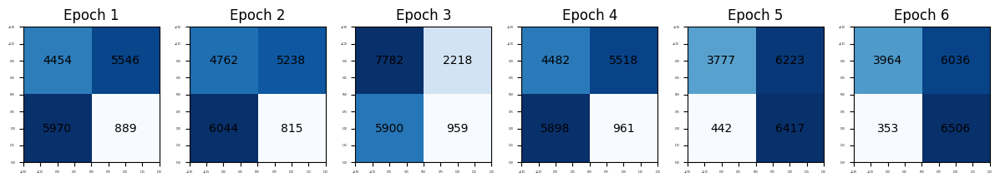

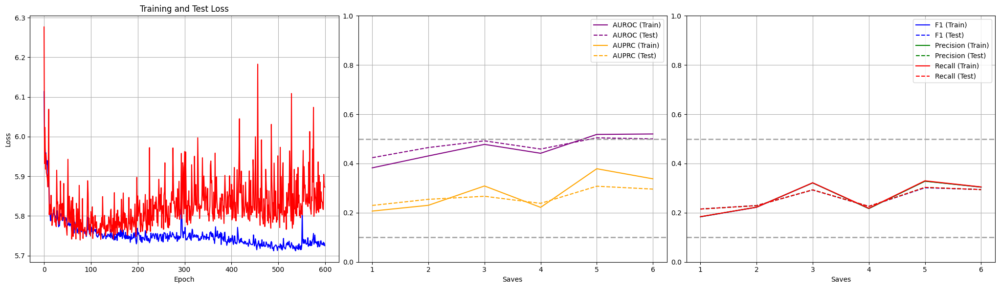

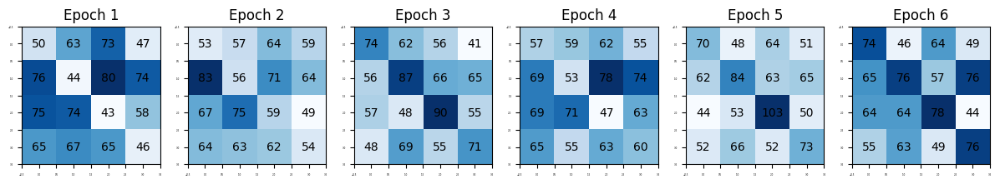

...

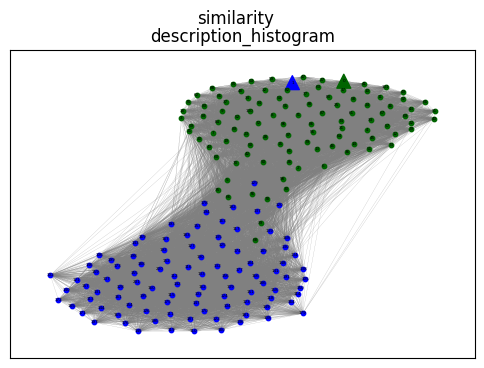

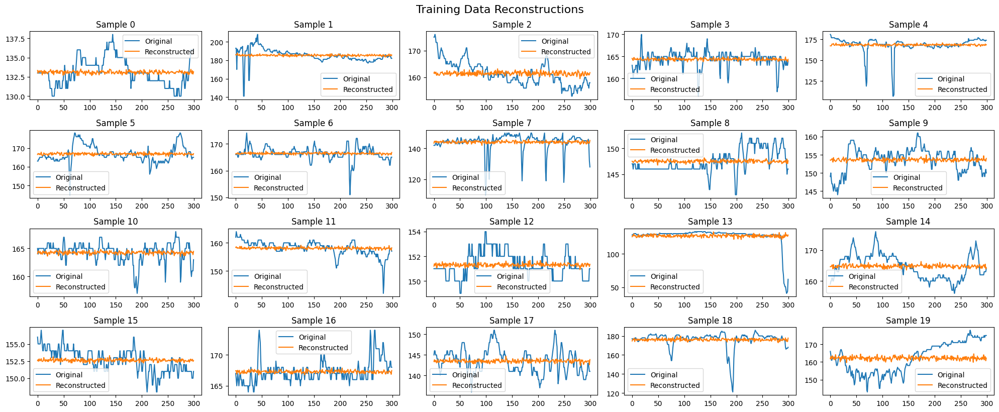

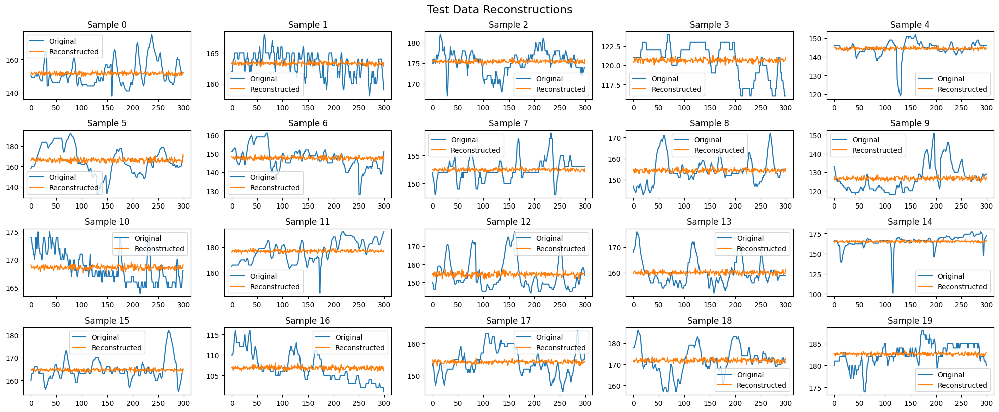

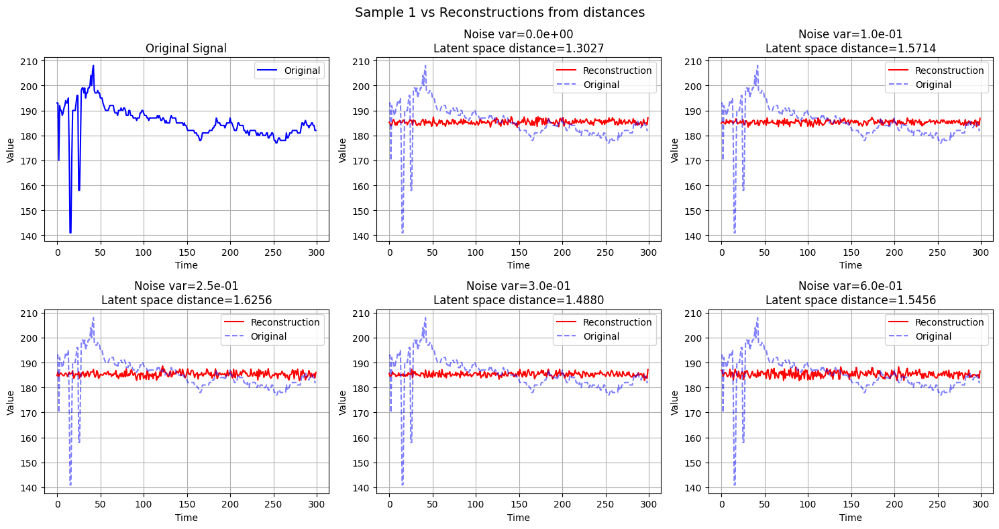

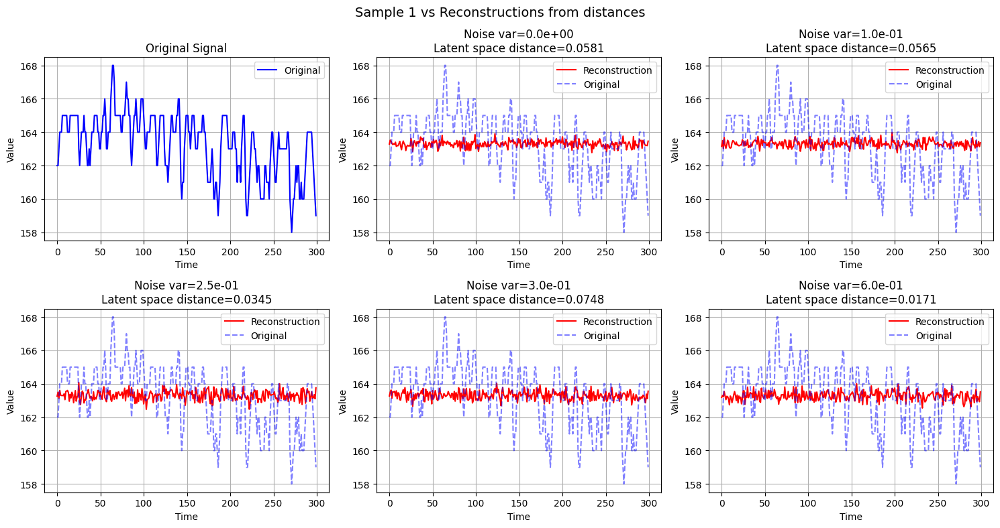

Epoch [1/100]
	Training Loss: 5.728727
	Testing Loss: 5.879381
	Learning Rate: 0.000090000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.726614
	Testing Loss: 5.823488
	Learning Rate: 0.000090000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.721765
	Testing Loss: 5.799546
	Learning Rate: 0.000090000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.727181
	Testing Loss: 5.814881
	Learning Rate: 0.000090000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.724079
	Testing Loss: 5.870684
	Learning Rate: 0.000090000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.716588
	Testing Loss: 5.855741
	Learning Rate: 0.000090000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.709810
	Testing Loss: 5.812124
	Learning Rate: 0.000090000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.709421
	Testing Loss: 5.791162
	Learning Rate: 0.000090000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.720331
	Testing Loss: 5.824922
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.720733
	Testing Loss: 5.805973
	Learning Rate: 0.0

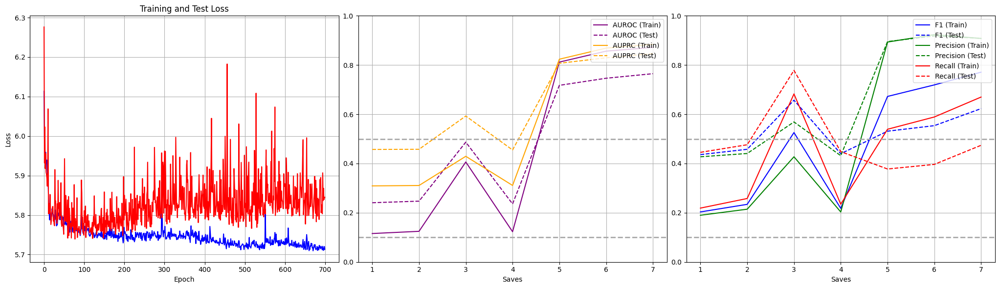

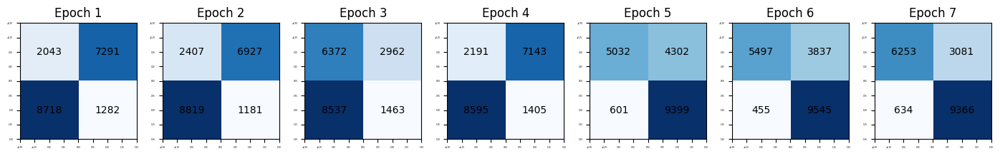

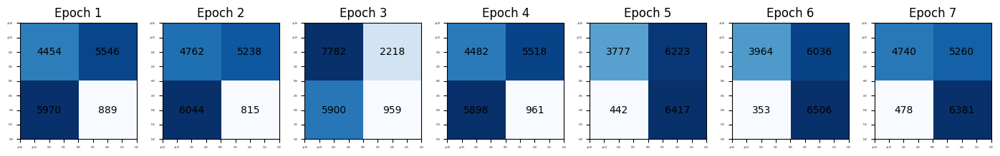

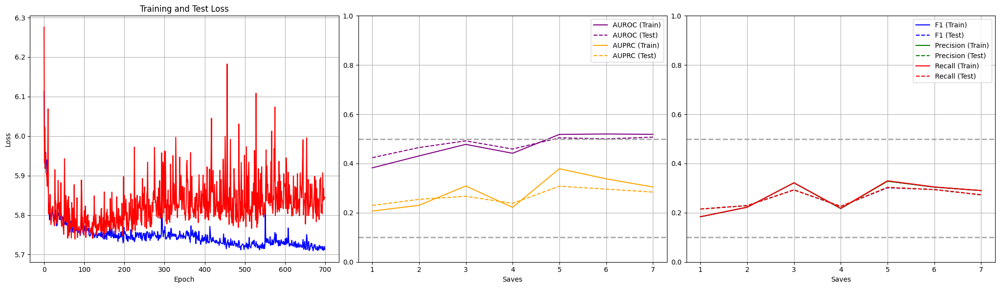

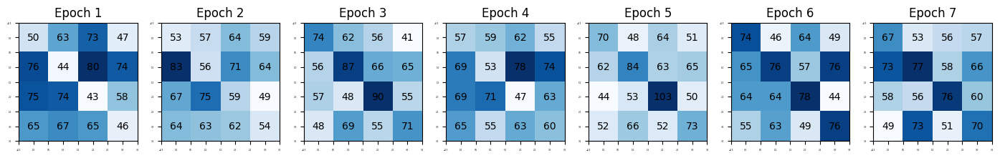

...

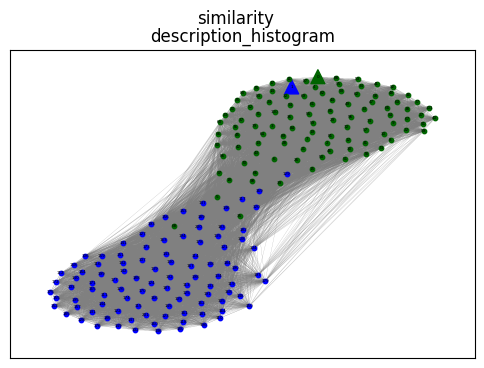

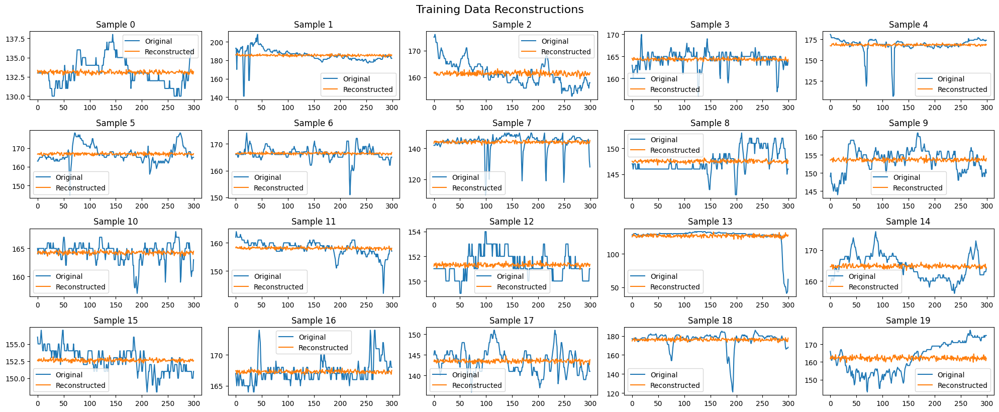

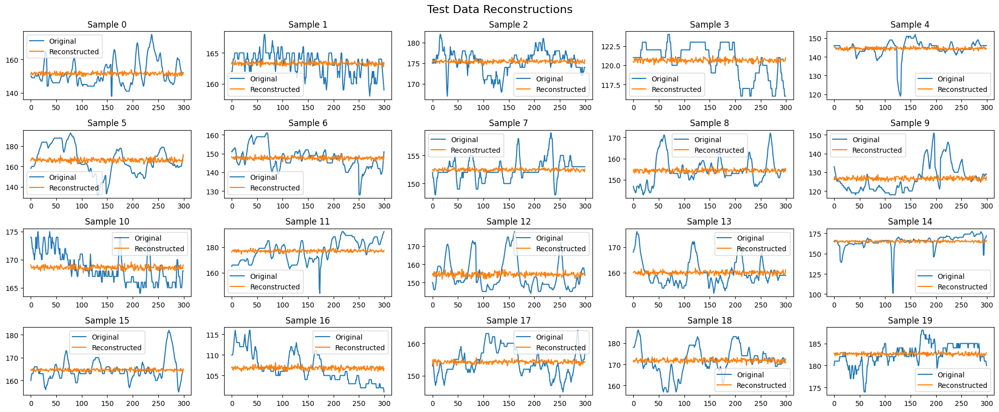

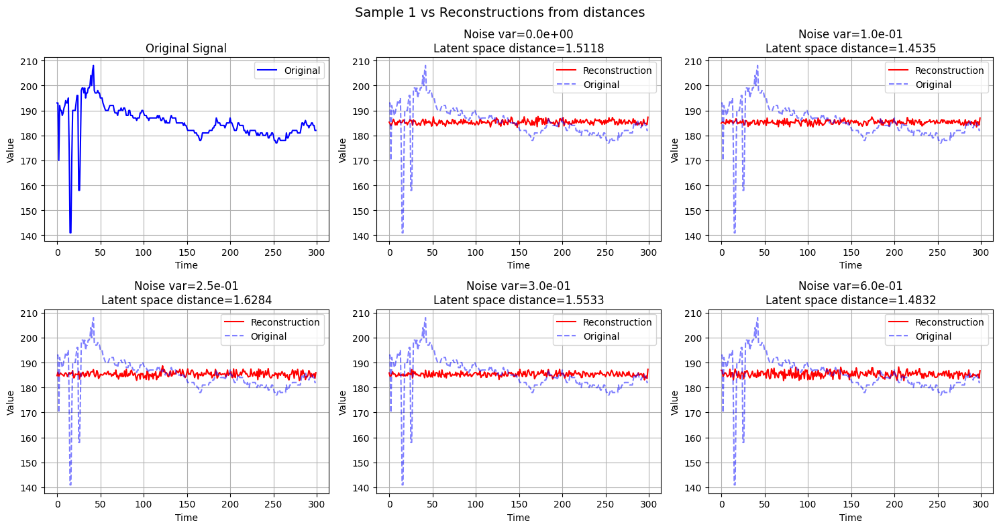

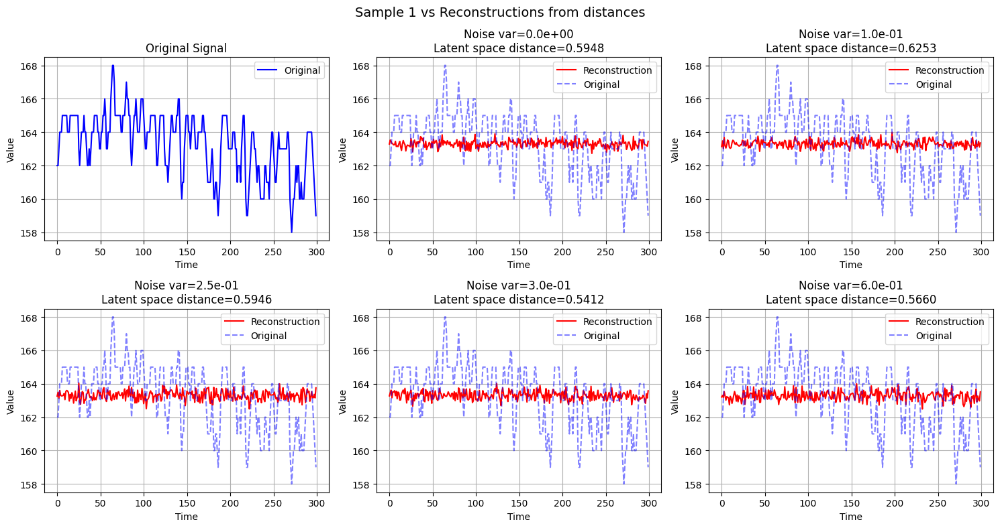

Epoch [1/100]
	Training Loss: 5.710098
	Testing Loss: 5.832265
	Learning Rate: 0.000090000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.719788
	Testing Loss: 5.810246
	Learning Rate: 0.000090000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.709715
	Testing Loss: 5.835764
	Learning Rate: 0.000090000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.714280
	Testing Loss: 5.829709
	Learning Rate: 0.000090000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.716737
	Testing Loss: 5.832125
	Learning Rate: 0.000090000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.708654
	Testing Loss: 5.840813
	Learning Rate: 0.000090000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.719468
	Testing Loss: 5.813360
	Learning Rate: 0.000090000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.711467
	Testing Loss: 5.870990
	Learning Rate: 0.000090000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.707474
	Testing Loss: 5.819873
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.710911
	Testing Loss: 5.825783
	Learning Rate: 0.0

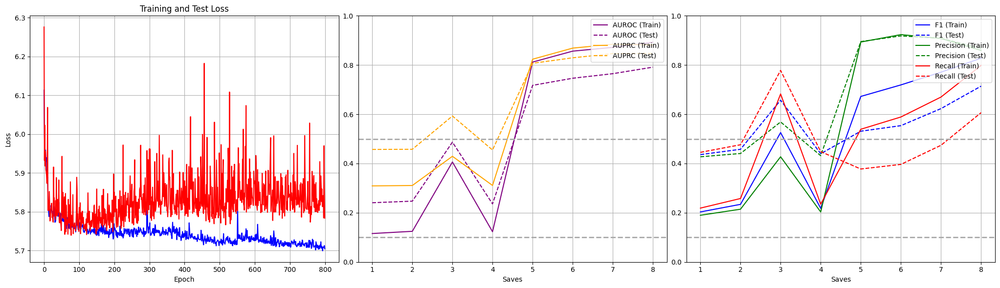

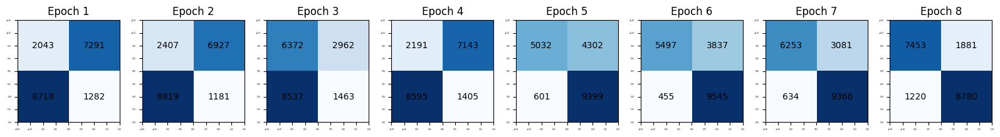

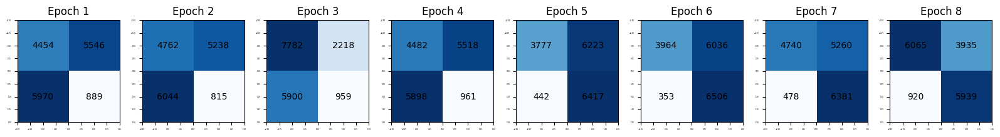

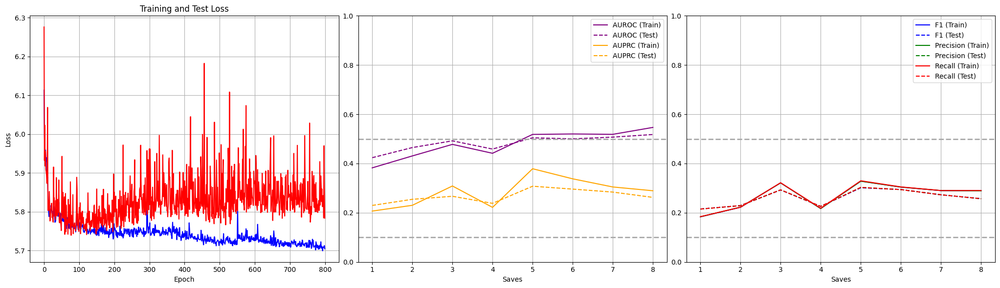

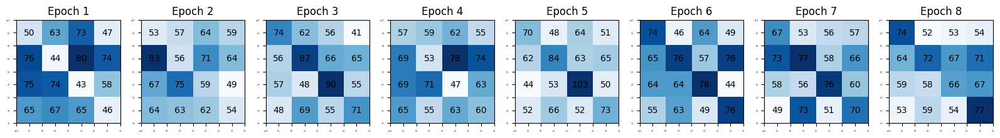

...

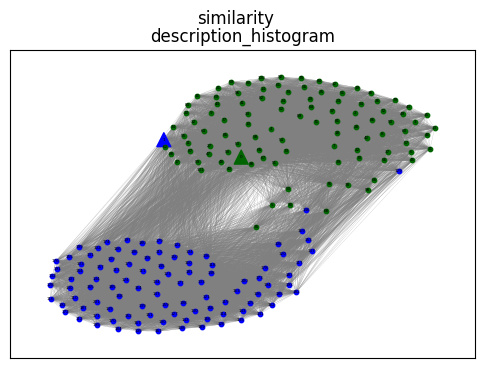

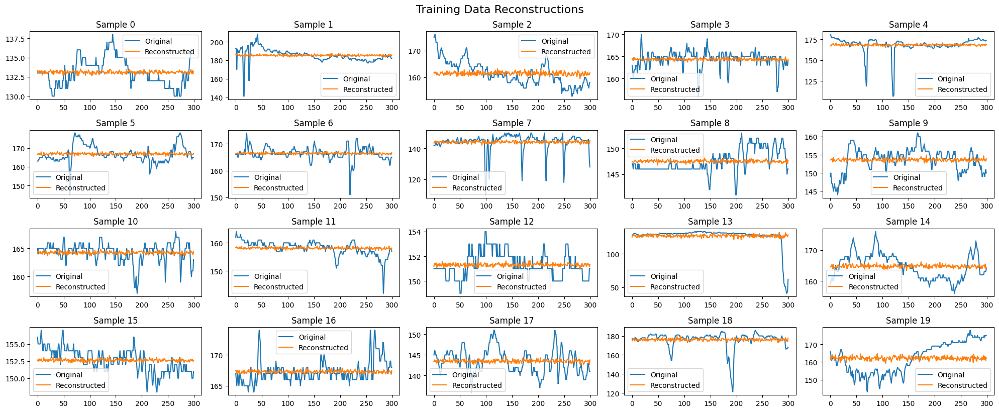

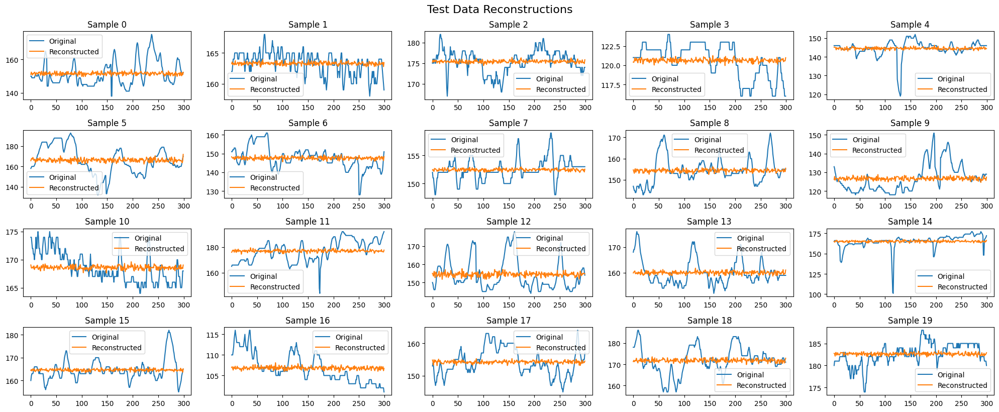

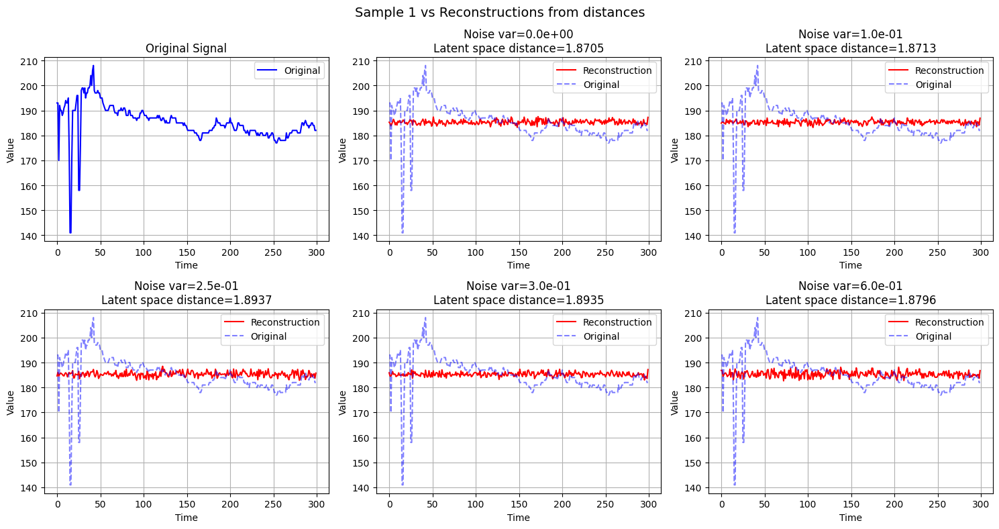

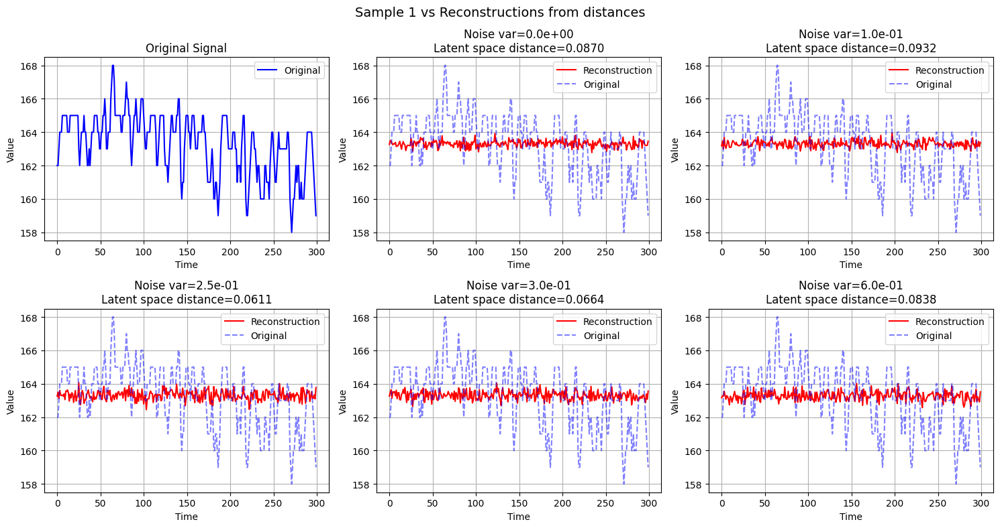

Epoch [1/100]
	Training Loss: 5.709053
	Testing Loss: 5.823358
	Learning Rate: 0.000090000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.745457
	Testing Loss: 5.844498
	Learning Rate: 0.000090000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.709740
	Testing Loss: 5.885615
	Learning Rate: 0.000090000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.715076
	Testing Loss: 5.952218
	Learning Rate: 0.000090000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.699543
	Testing Loss: 5.807559
	Learning Rate: 0.000090000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.702149
	Testing Loss: 5.858318
	Learning Rate: 0.000090000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.706529
	Testing Loss: 5.790327
	Learning Rate: 0.000090000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.697044
	Testing Loss: 5.862862
	Learning Rate: 0.000090000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.701876
	Testing Loss: 5.812212
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.697588
	Testing Loss: 5.837259
	Learning Rate: 0.0

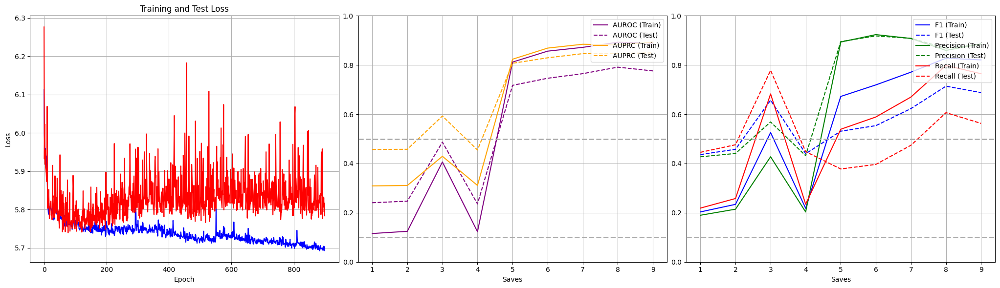

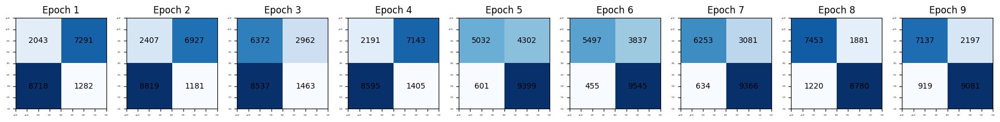

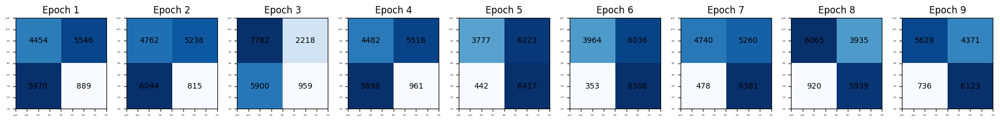

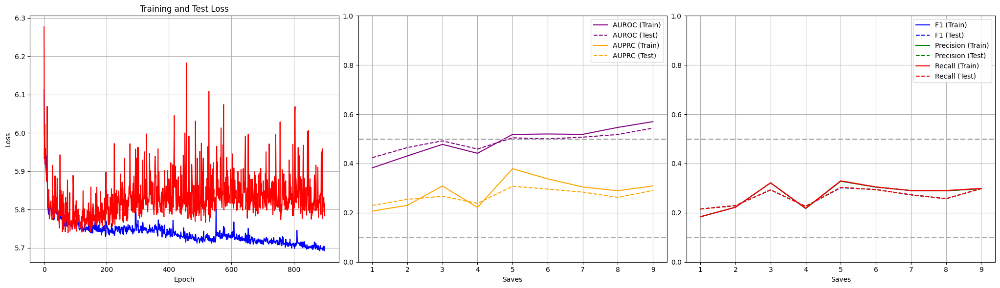

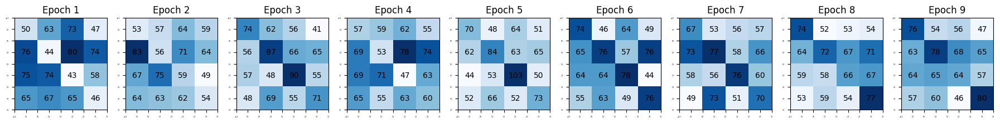

...

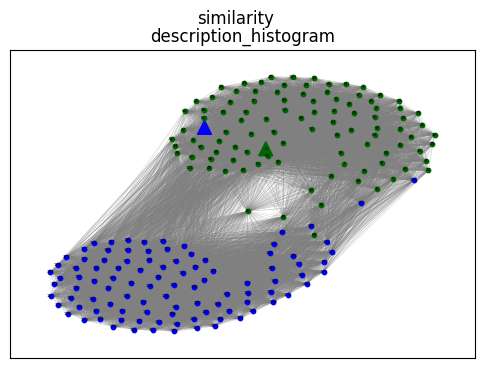

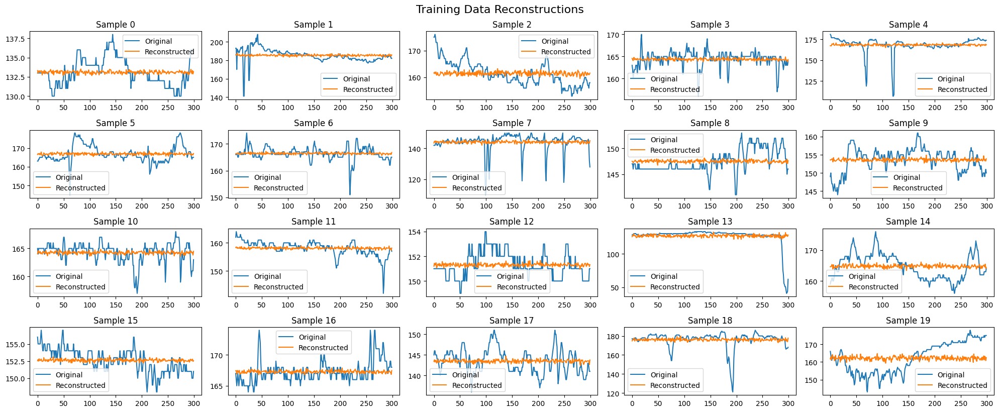

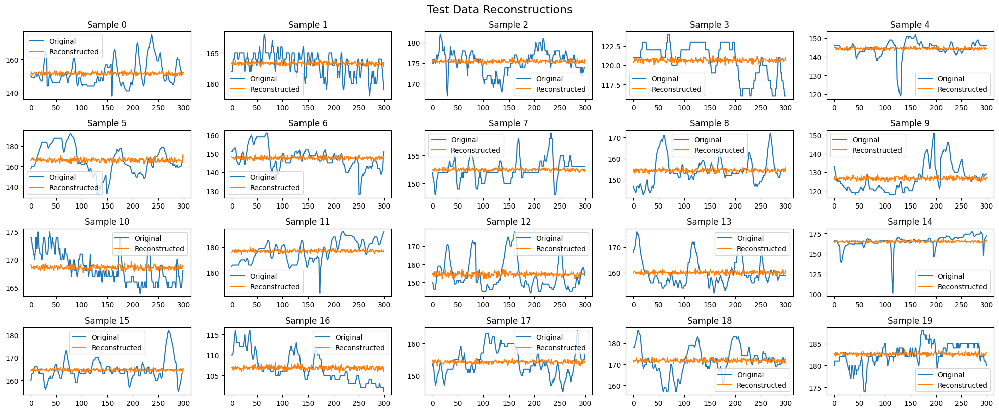

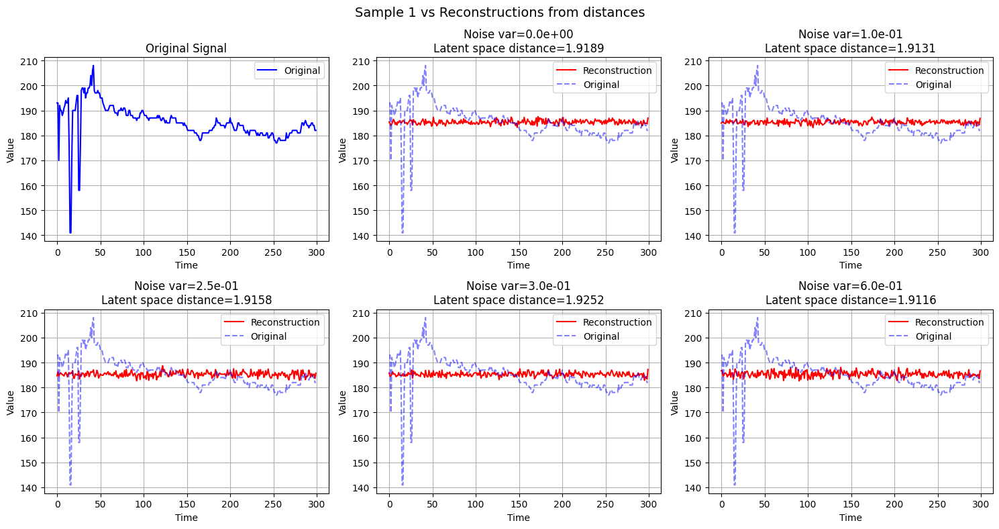

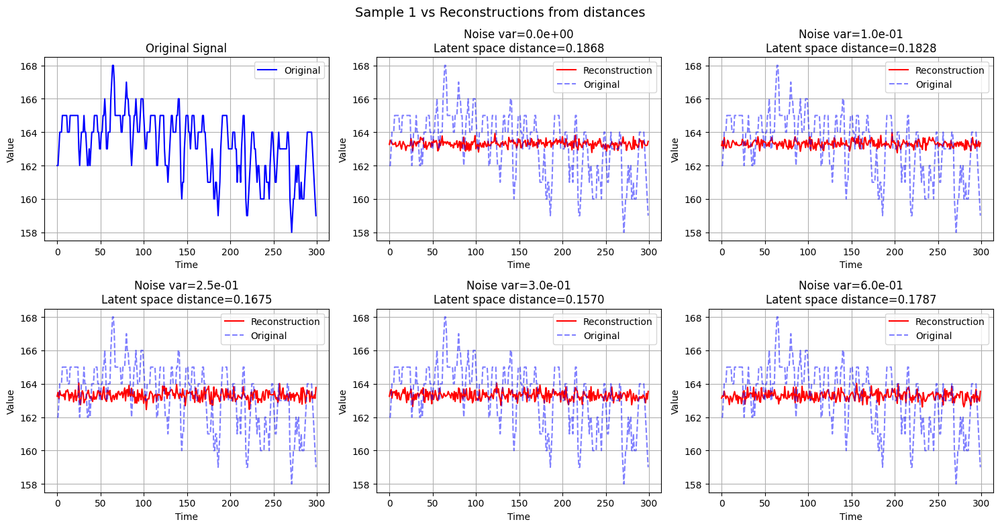

Epoch [1/100]
	Training Loss: 5.695490
	Testing Loss: 5.809998
	Learning Rate: 0.000090000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.698980
	Testing Loss: 5.808139
	Learning Rate: 0.000090000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.699406
	Testing Loss: 5.802106
	Learning Rate: 0.000090000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.689444
	Testing Loss: 5.795746
	Learning Rate: 0.000090000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.690173
	Testing Loss: 5.817980
	Learning Rate: 0.000090000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.696382
	Testing Loss: 5.797963
	Learning Rate: 0.000090000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.699857
	Testing Loss: 5.852028
	Learning Rate: 0.000090000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.689791
	Testing Loss: 5.804211
	Learning Rate: 0.000090000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.703176
	Testing Loss: 5.815632
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.692445
	Testing Loss: 5.807706
	Learning Rate: 0.0

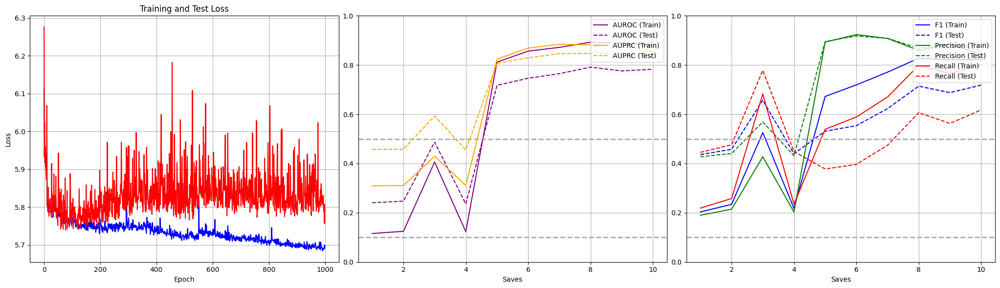

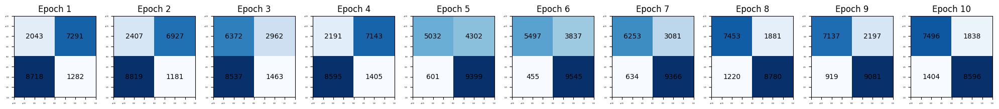

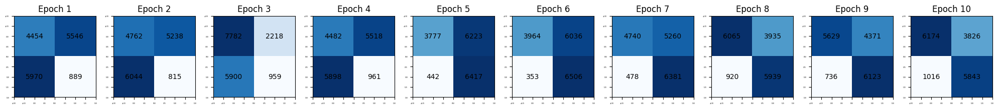

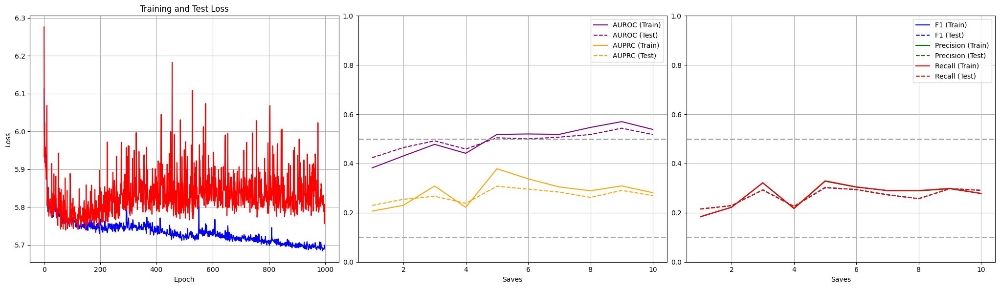

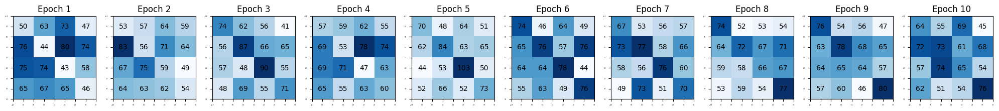

...

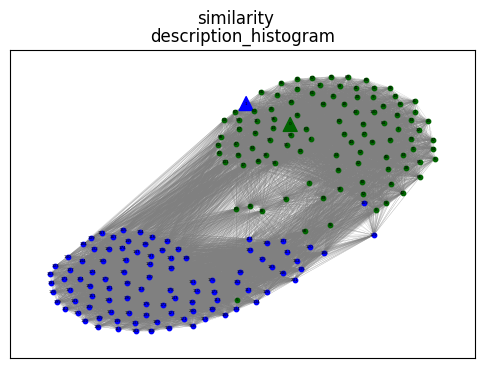

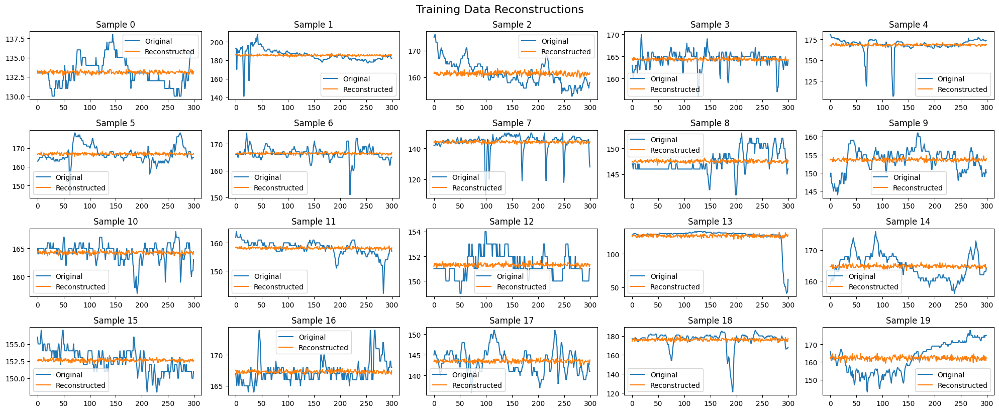

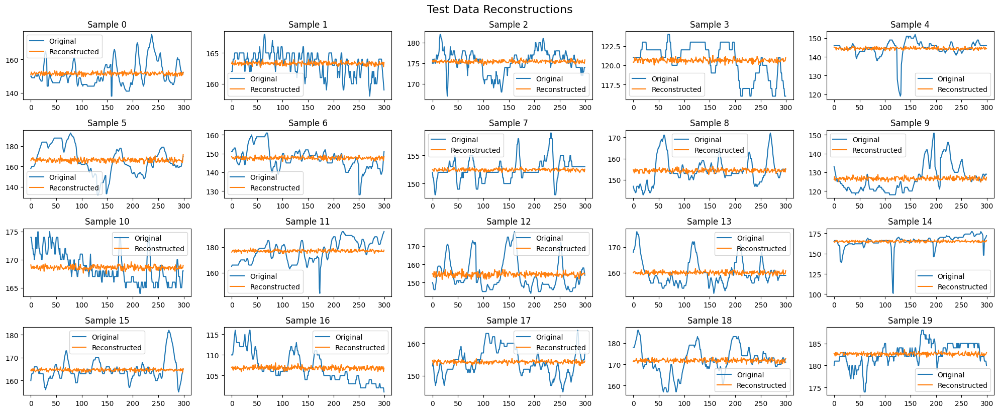

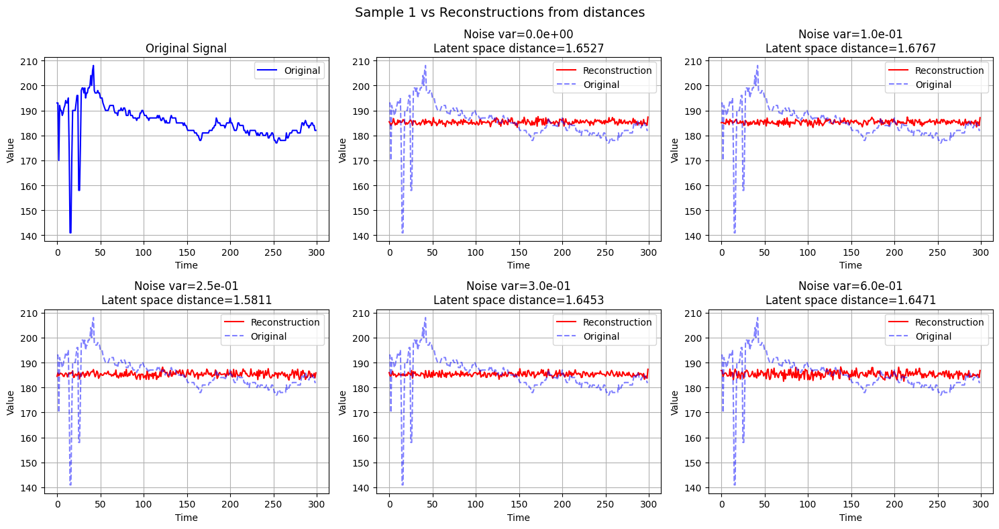

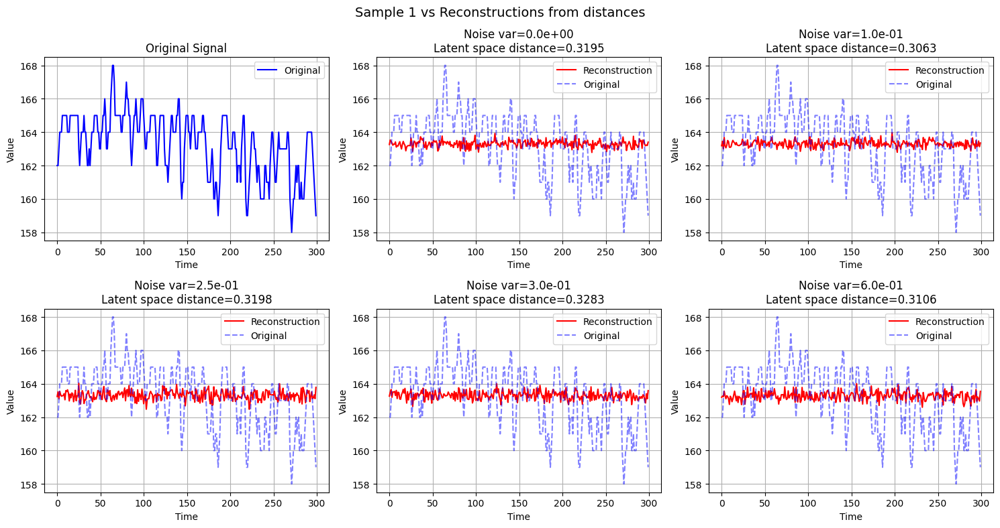

Epoch [1/100]
	Training Loss: 5.684942
	Testing Loss: 5.824193
	Learning Rate: 0.000090000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.696843
	Testing Loss: 5.844914
	Learning Rate: 0.000090000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.693890
	Testing Loss: 5.881146
	Learning Rate: 0.000090000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.684630
	Testing Loss: 5.831871
	Learning Rate: 0.000090000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.688532
	Testing Loss: 5.898471
	Learning Rate: 0.000090000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.691588
	Testing Loss: 5.872576
	Learning Rate: 0.000090000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.684866
	Testing Loss: 5.885603
	Learning Rate: 0.000090000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.687226
	Testing Loss: 5.835703
	Learning Rate: 0.000090000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.682440
	Testing Loss: 5.801123
	Learning Rate: 0.000090000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.685569
	Testing Loss: 5.848533
	Learning Rate: 0.0

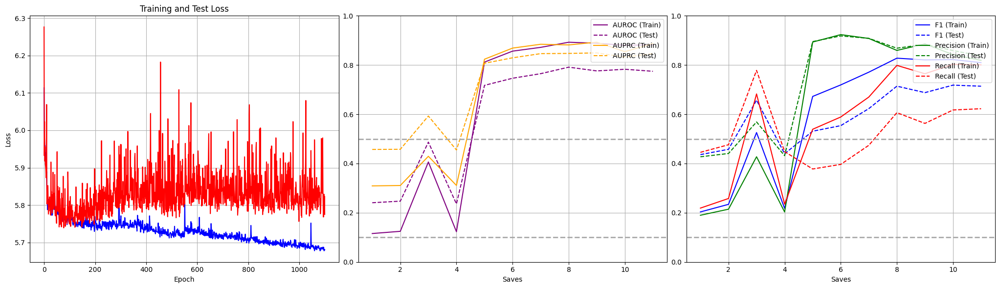

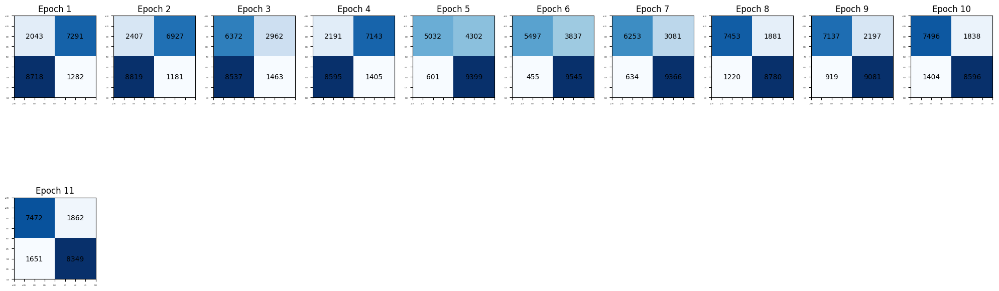

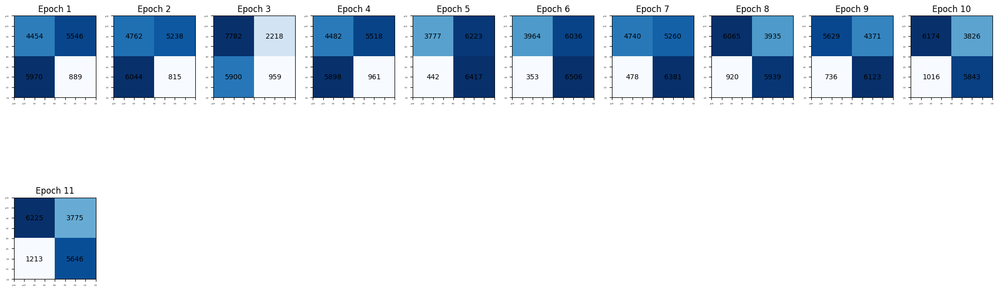

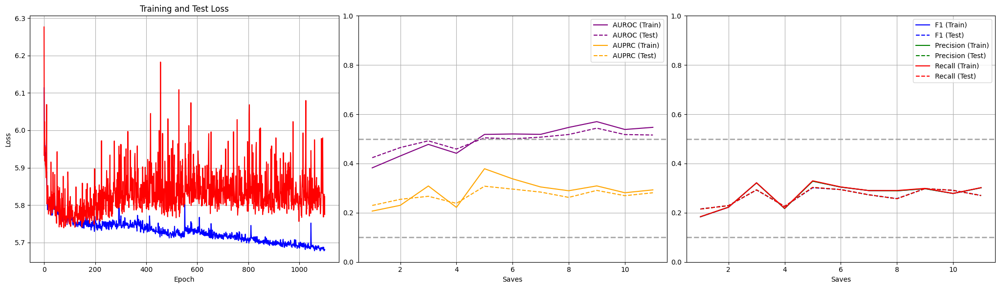

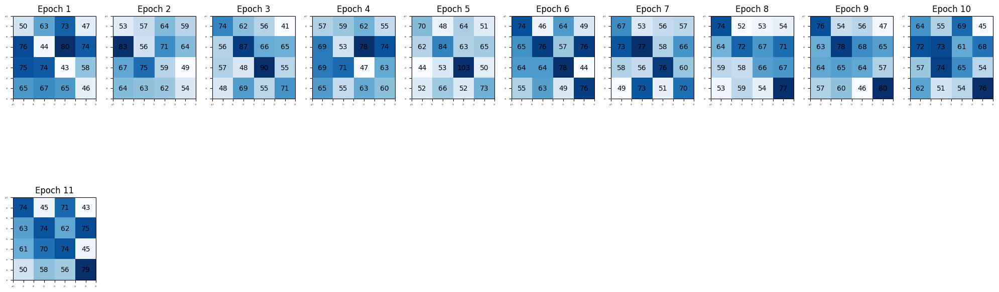

...

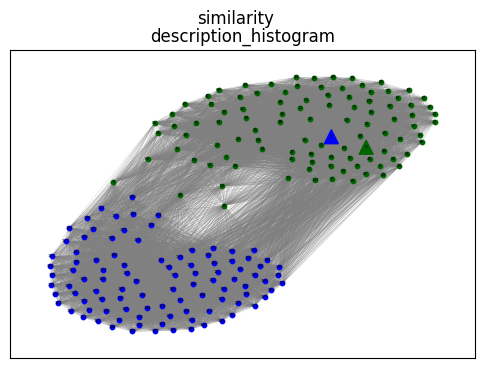

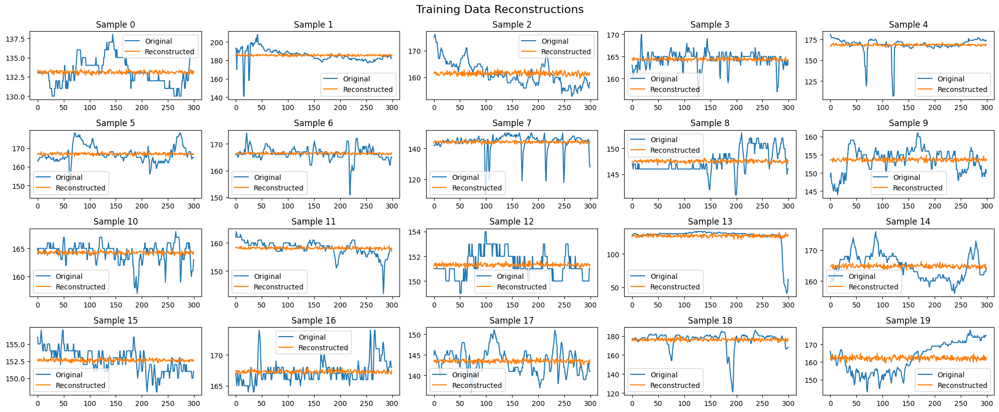

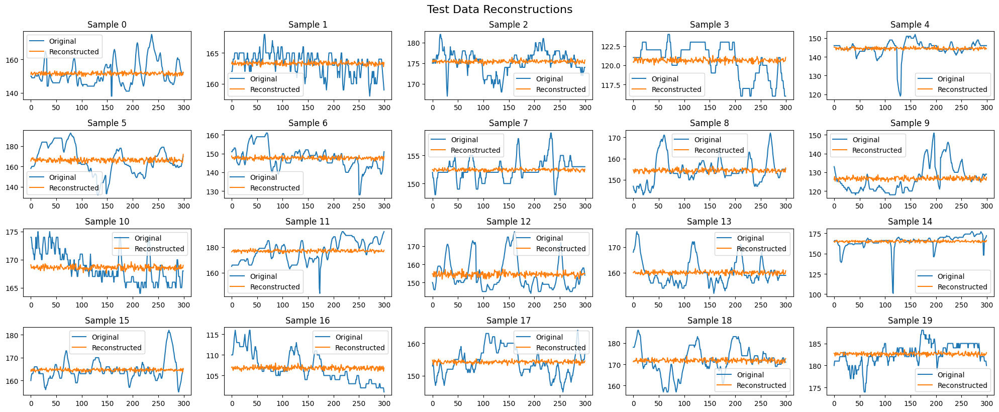

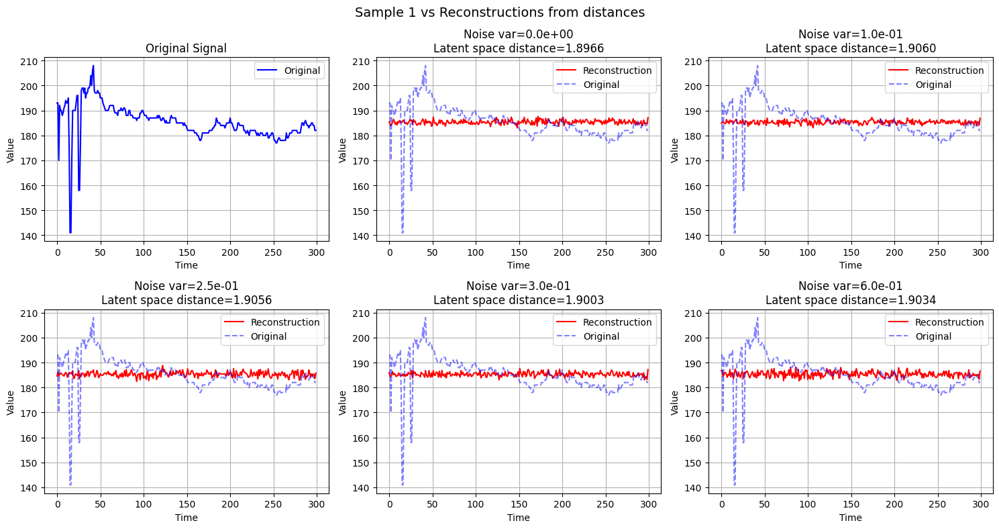

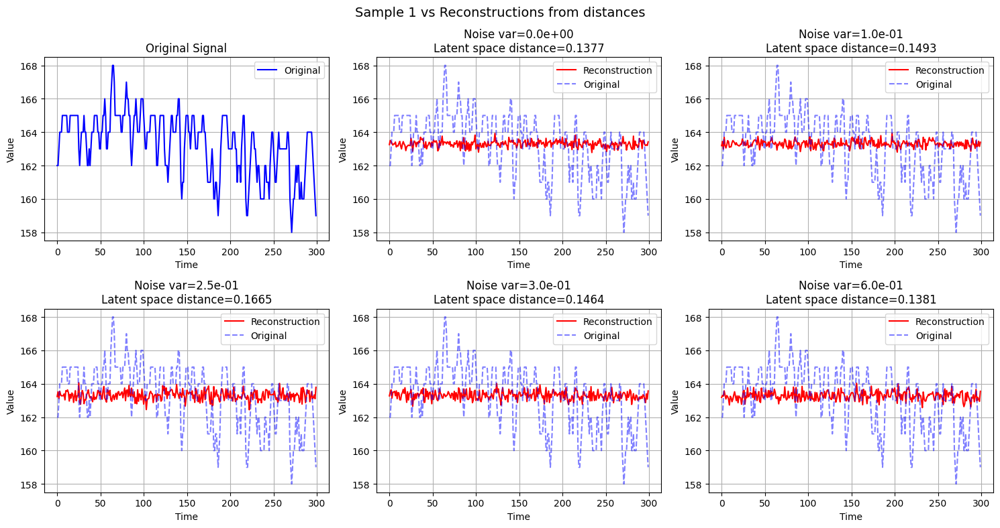

Epoch [1/100]
	Training Loss: 5.678025
	Testing Loss: 5.820125
	Learning Rate: 0.000081000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.681121
	Testing Loss: 5.825109
	Learning Rate: 0.000081000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.679506
	Testing Loss: 5.798773
	Learning Rate: 0.000081000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.675514
	Testing Loss: 5.805173
	Learning Rate: 0.000081000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.676142
	Testing Loss: 5.833432
	Learning Rate: 0.000081000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.681948
	Testing Loss: 5.890841
	Learning Rate: 0.000081000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.681271
	Testing Loss: 5.835036
	Learning Rate: 0.000081000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.673064
	Testing Loss: 5.811371
	Learning Rate: 0.000081000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.678000
	Testing Loss: 5.806936
	Learning Rate: 0.000081000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.685781
	Testing Loss: 5.822135
	Learning Rate: 0.0

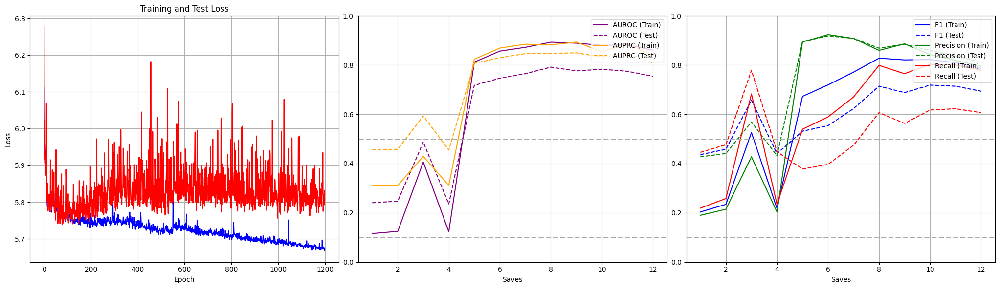

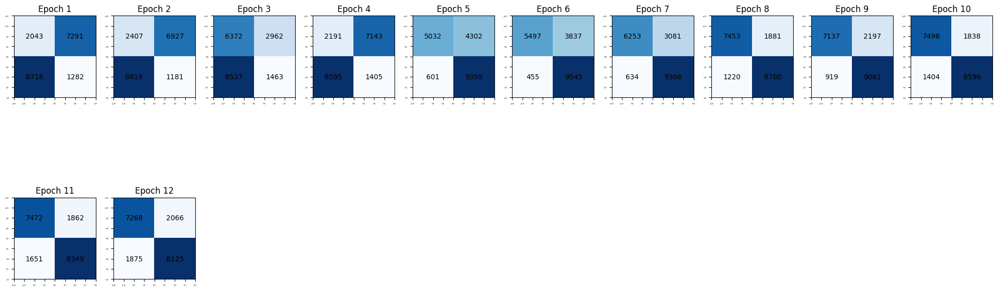

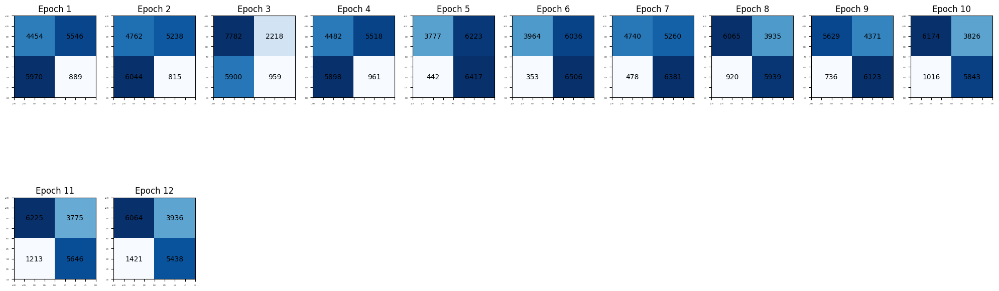

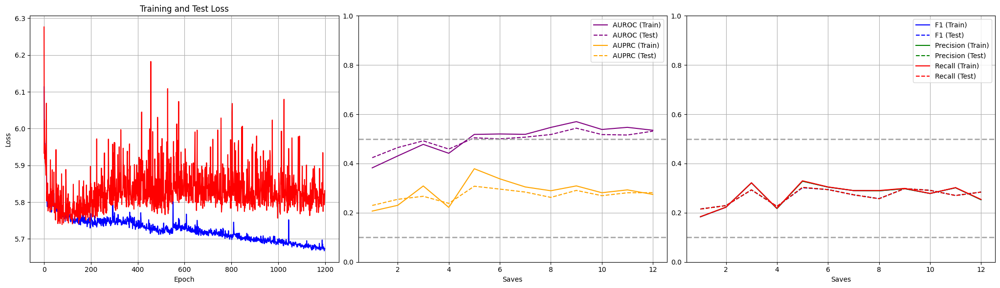

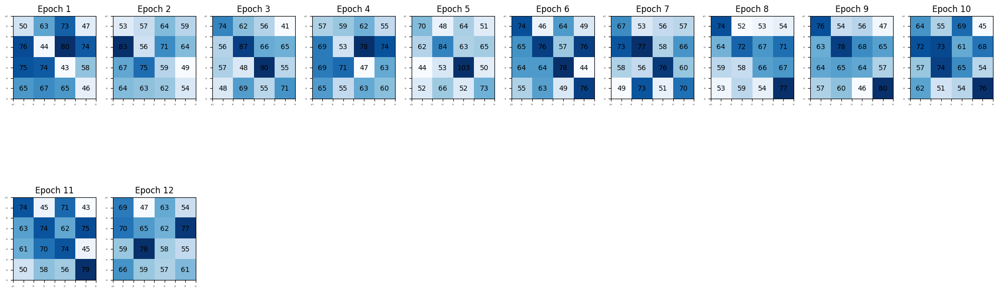

...

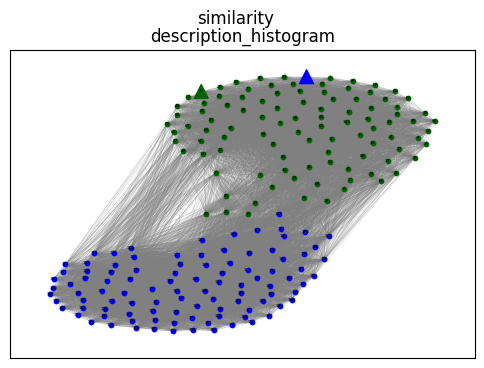

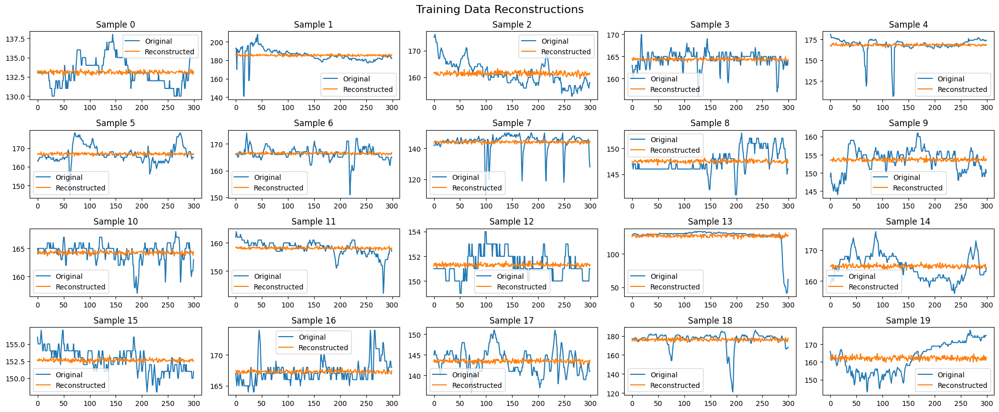

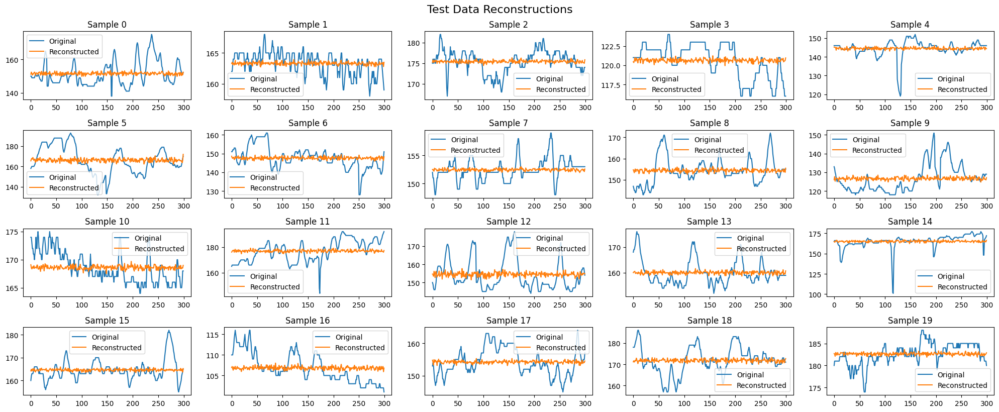

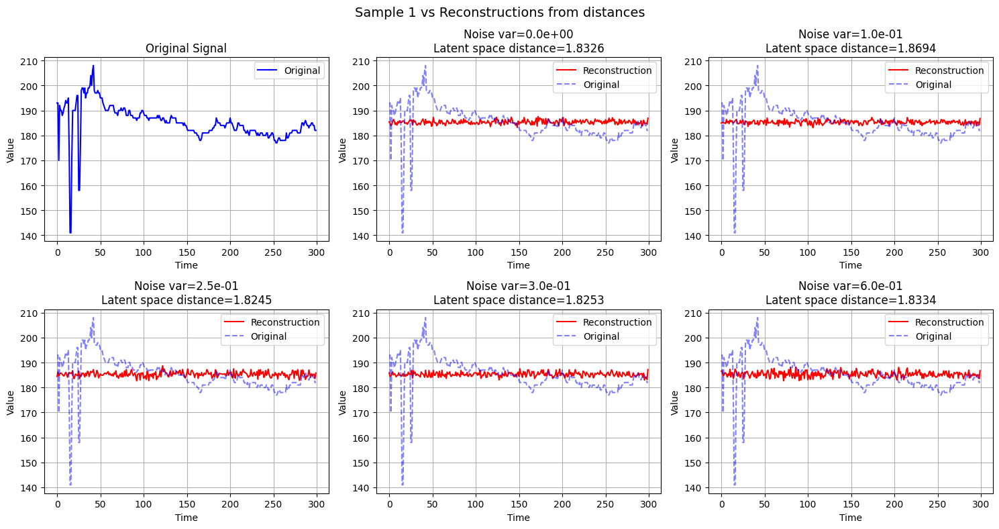

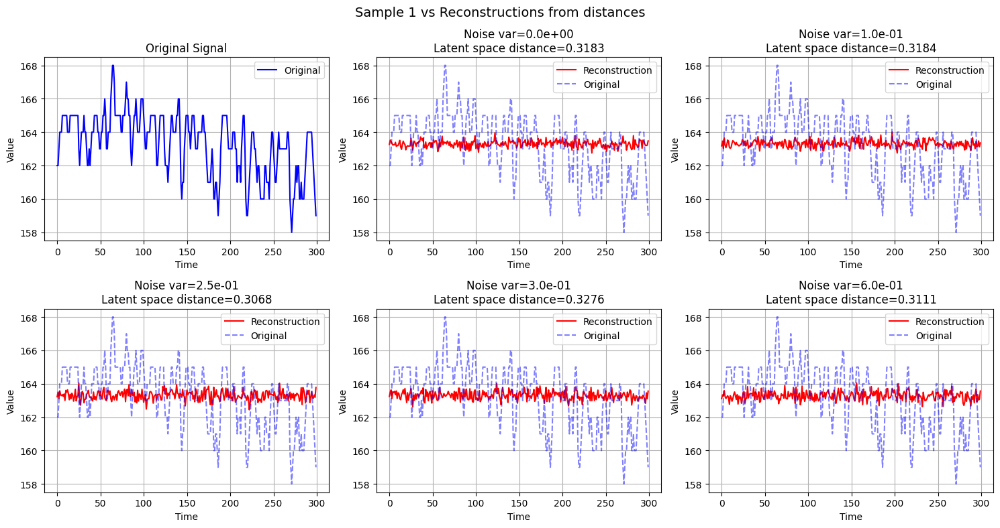

Epoch [1/100]
	Training Loss: 5.670704
	Testing Loss: 5.803992
	Learning Rate: 0.000081000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.671647
	Testing Loss: 5.830022
	Learning Rate: 0.000081000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.669973
	Testing Loss: 5.824265
	Learning Rate: 0.000081000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.663503
	Testing Loss: 5.791188
	Learning Rate: 0.000081000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.671741
	Testing Loss: 5.862523
	Learning Rate: 0.000081000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.669331
	Testing Loss: 5.808448
	Learning Rate: 0.000081000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.672007
	Testing Loss: 5.797728
	Learning Rate: 0.000081000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.665566
	Testing Loss: 5.836261
	Learning Rate: 0.000081000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.663914
	Testing Loss: 5.825081
	Learning Rate: 0.000081000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.670565
	Testing Loss: 5.808500
	Learning Rate: 0.0

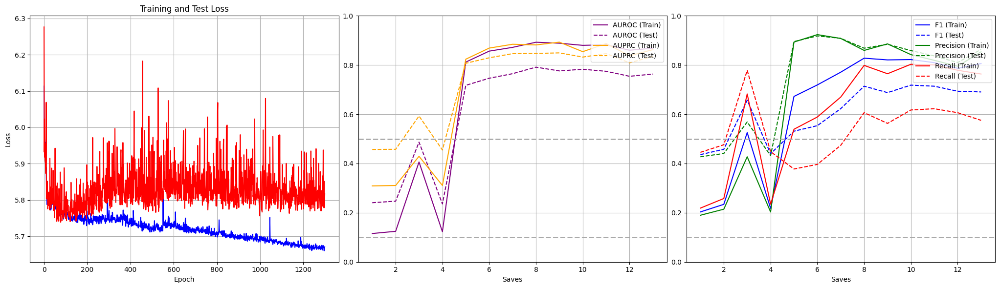

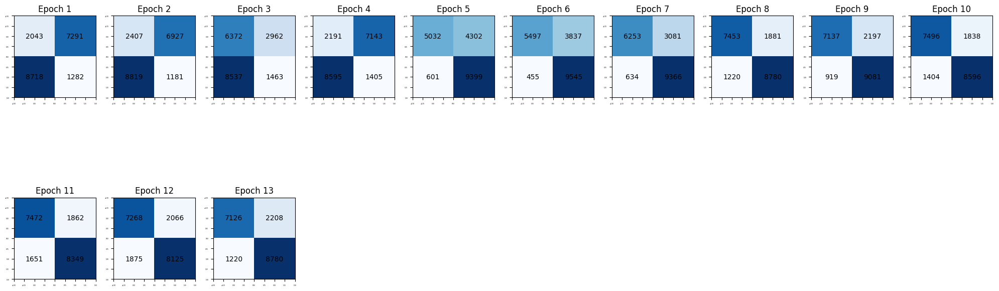

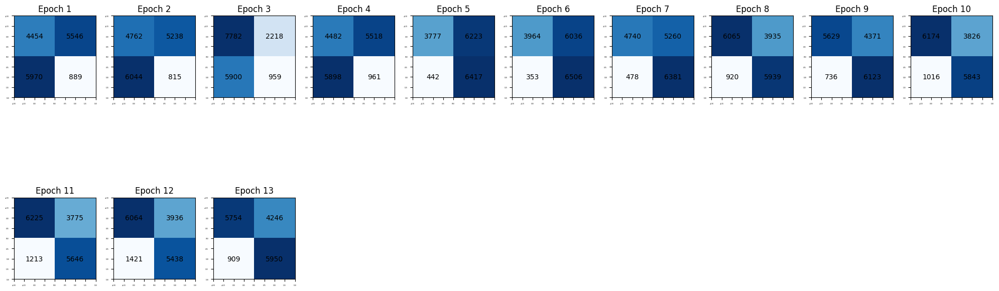

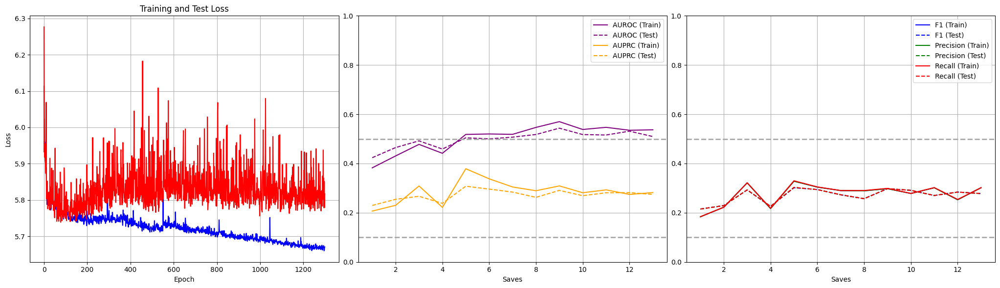

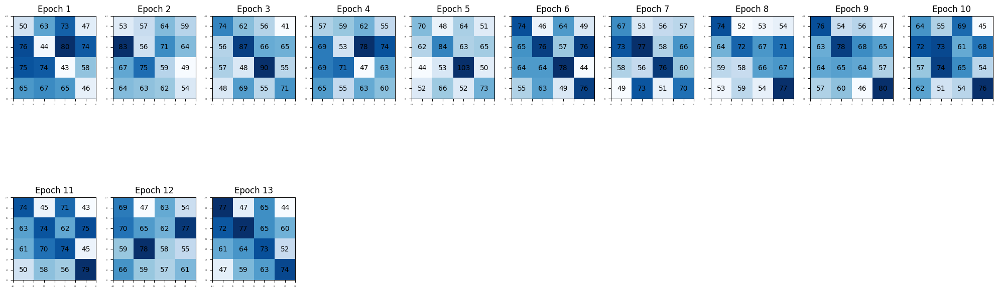

...

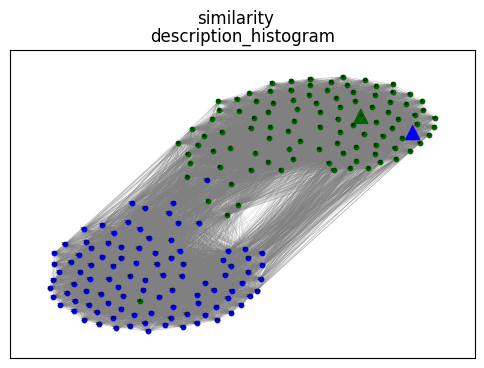

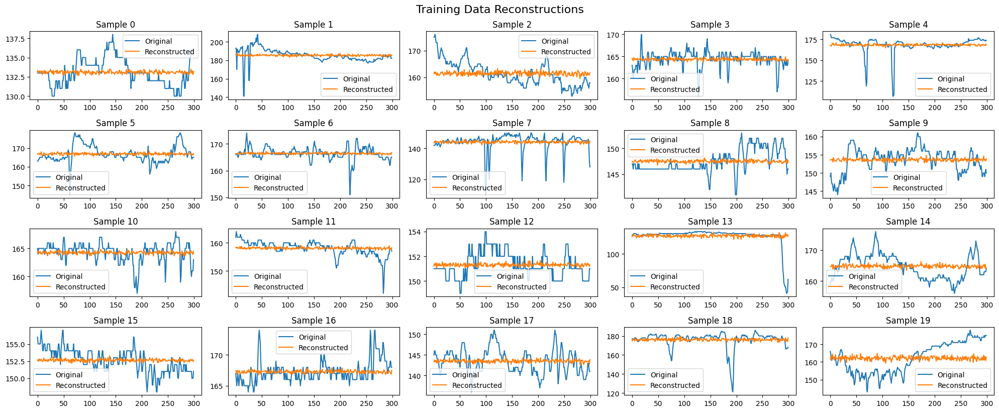

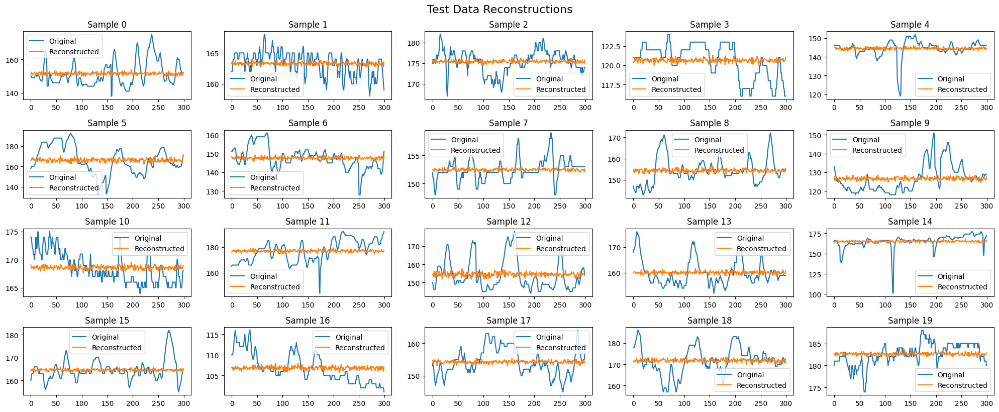

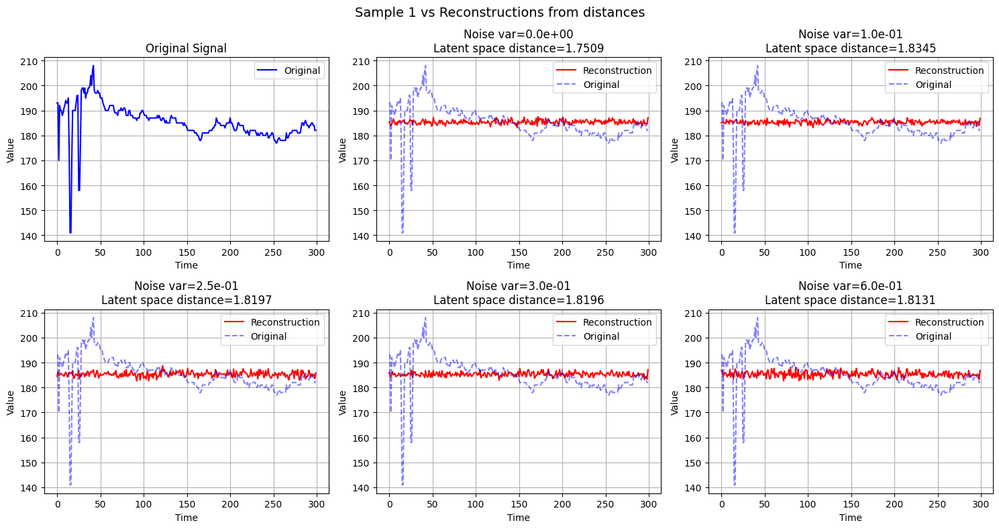

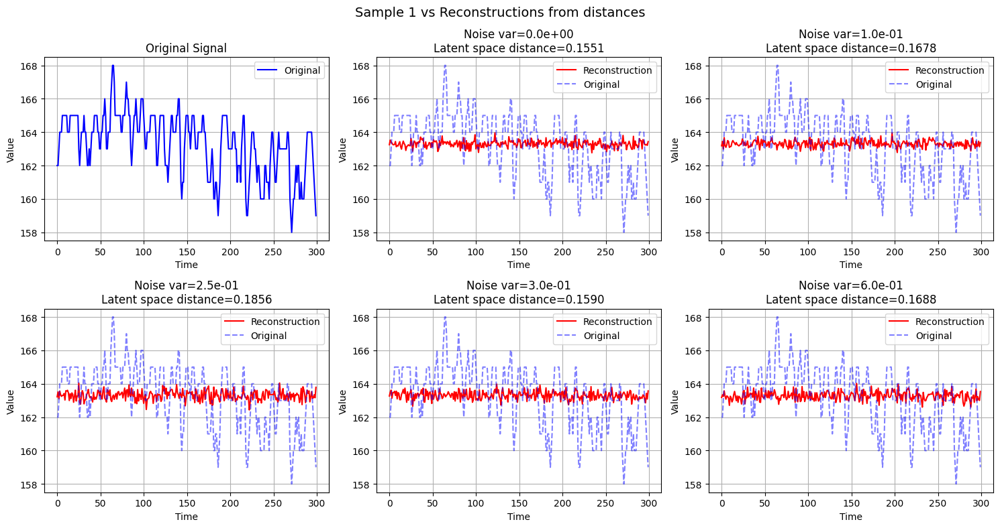

Epoch [1/100]
	Training Loss: 5.666579
	Testing Loss: 5.835516
	Learning Rate: 0.000081000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.669439
	Testing Loss: 5.821732
	Learning Rate: 0.000081000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.674186
	Testing Loss: 5.830421
	Learning Rate: 0.000081000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.659204
	Testing Loss: 5.802874
	Learning Rate: 0.000081000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.666914
	Testing Loss: 5.911002
	Learning Rate: 0.000081000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.662416
	Testing Loss: 5.774036
	Learning Rate: 0.000081000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.662788
	Testing Loss: 5.861779
	Learning Rate: 0.000081000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.657709
	Testing Loss: 5.837869
	Learning Rate: 0.000081000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.664193
	Testing Loss: 5.816469
	Learning Rate: 0.000081000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.665798
	Testing Loss: 5.776451
	Learning Rate: 0.0

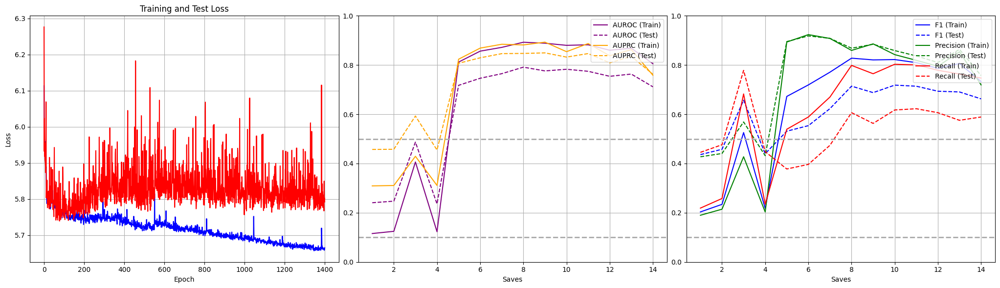

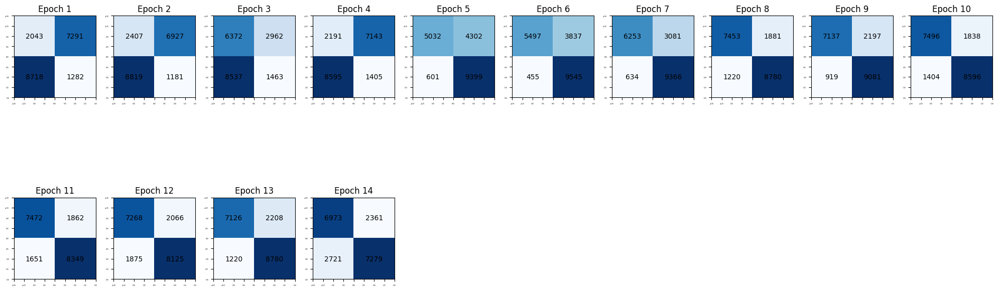

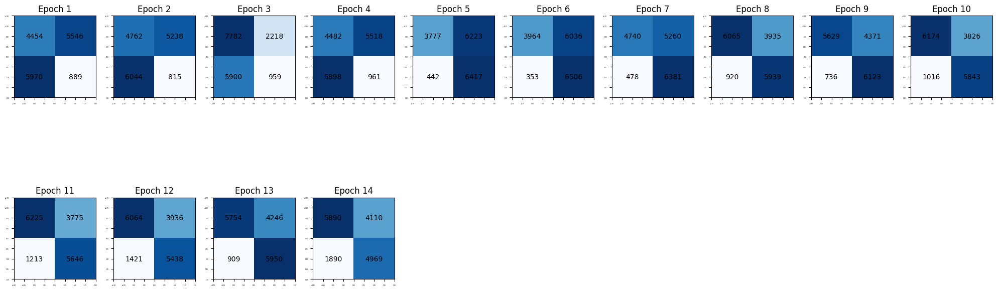

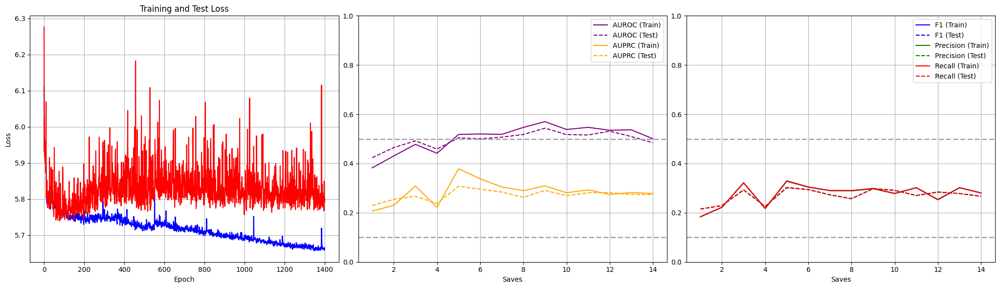

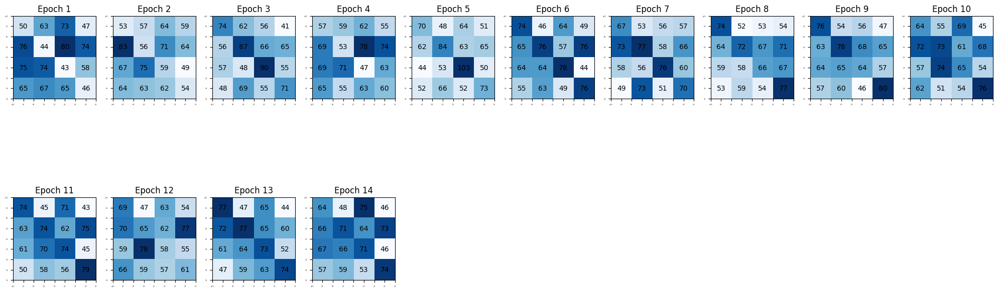

...

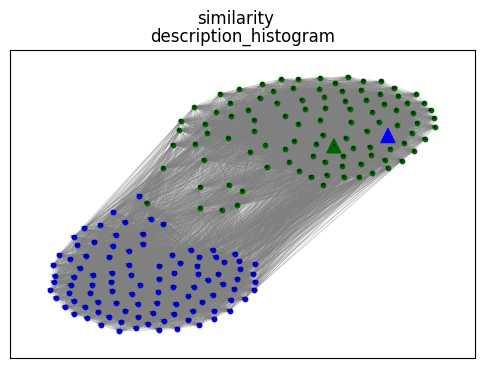

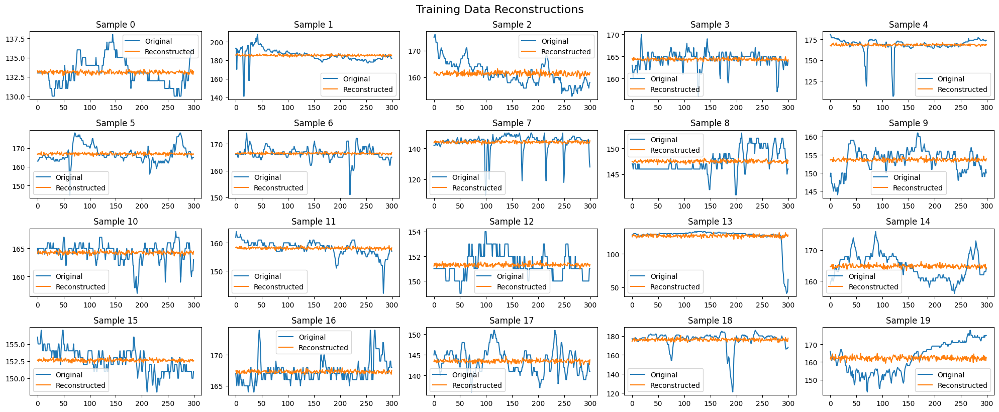

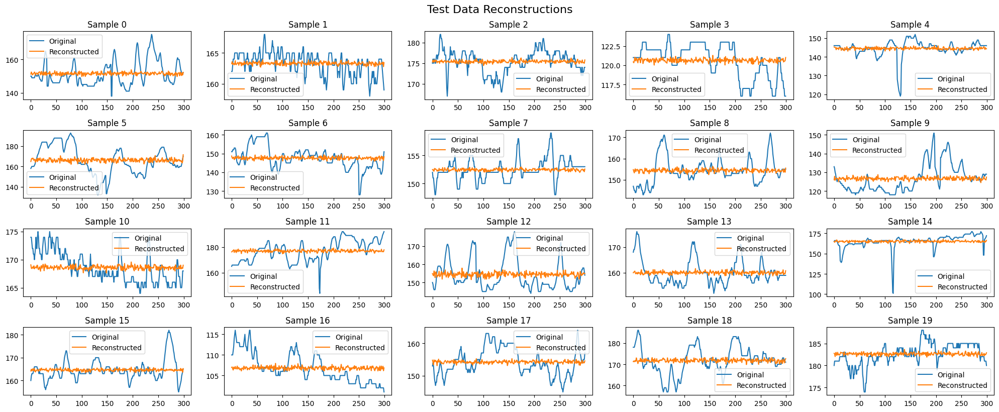

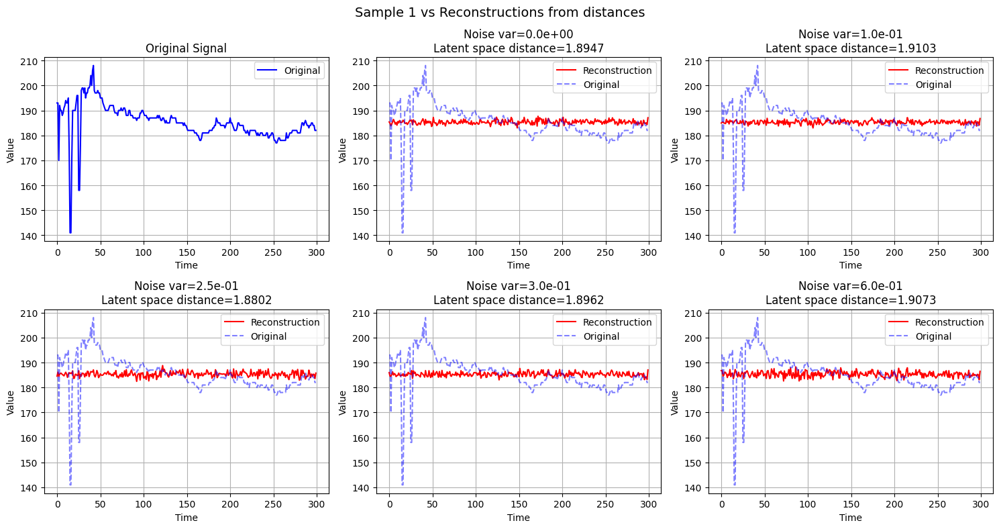

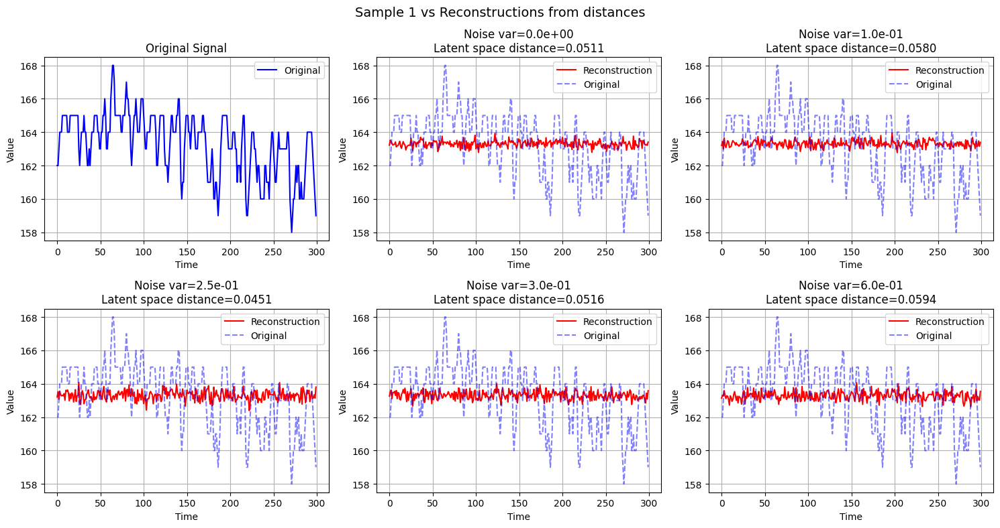

Epoch [1/100]
	Training Loss: 5.663100
	Testing Loss: 5.822638
	Learning Rate: 0.000081000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.663929
	Testing Loss: 5.809519
	Learning Rate: 0.000081000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.666635
	Testing Loss: 5.958726
	Learning Rate: 0.000081000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.653431
	Testing Loss: 5.777954
	Learning Rate: 0.000081000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.657278
	Testing Loss: 5.796671
	Learning Rate: 0.000081000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.655111
	Testing Loss: 5.788943
	Learning Rate: 0.000081000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.660679
	Testing Loss: 5.798886
	Learning Rate: 0.000081000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.654804
	Testing Loss: 5.820096
	Learning Rate: 0.000081000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.653998
	Testing Loss: 5.810538
	Learning Rate: 0.000081000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.656012
	Testing Loss: 5.810364
	Learning Rate: 0.0

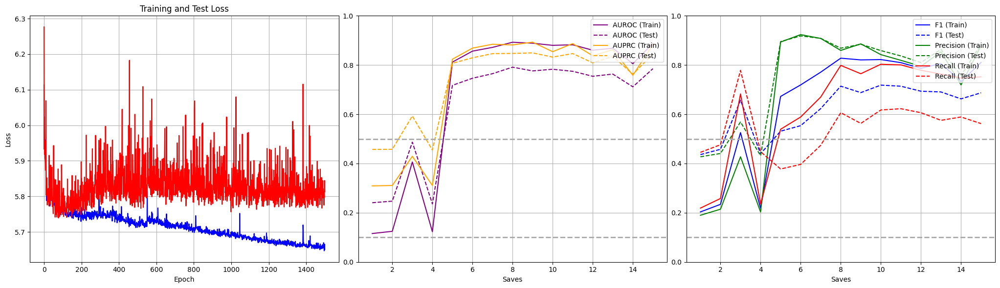

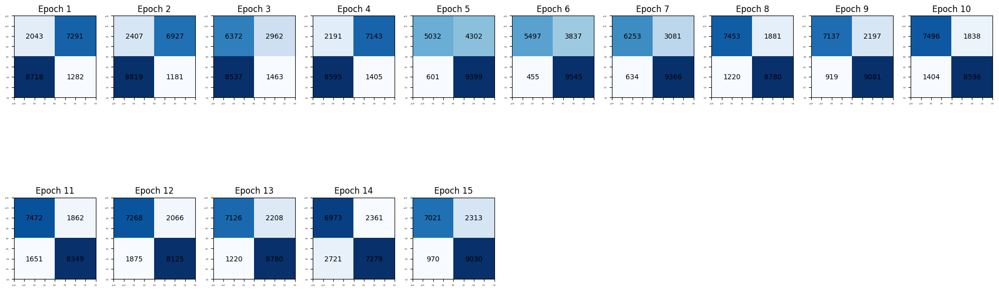

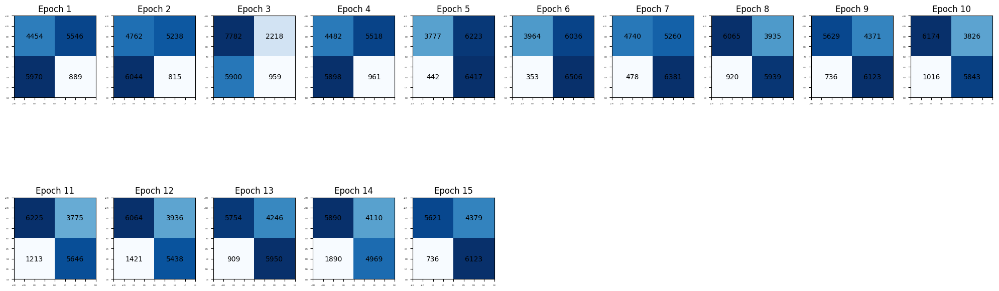

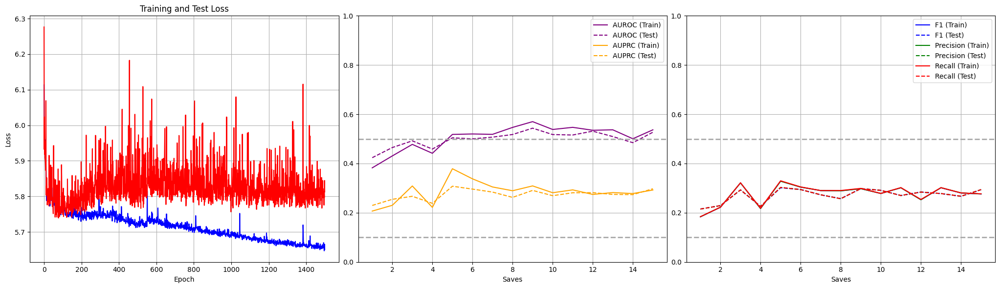

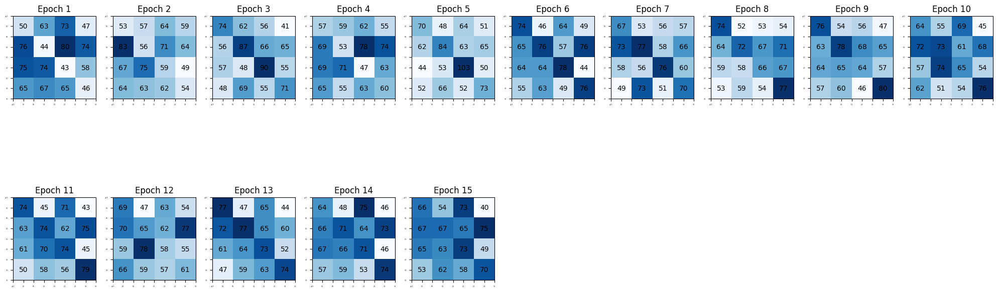

...

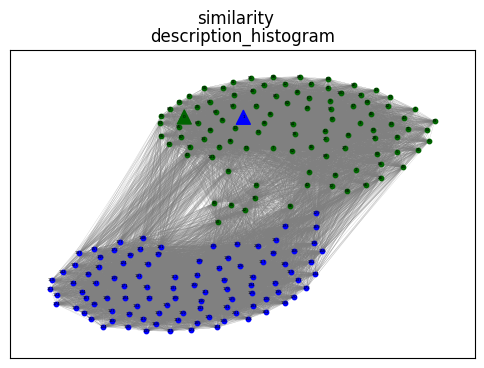

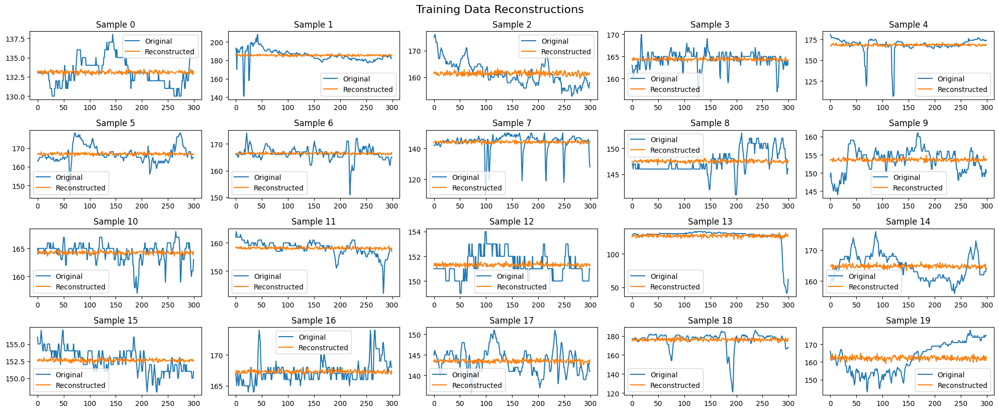

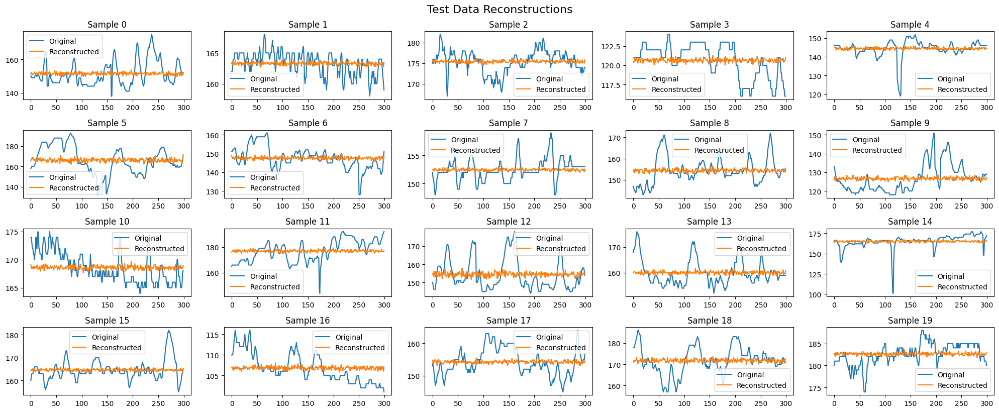

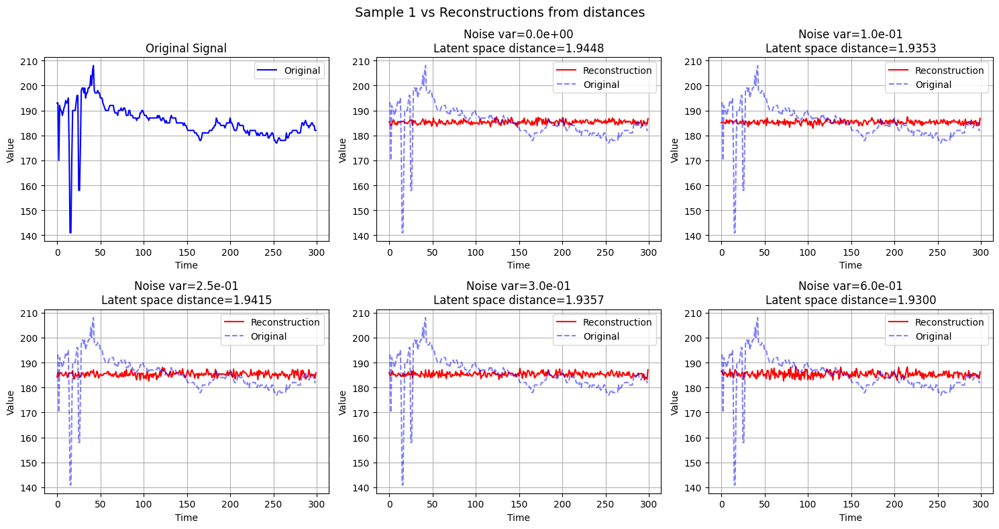

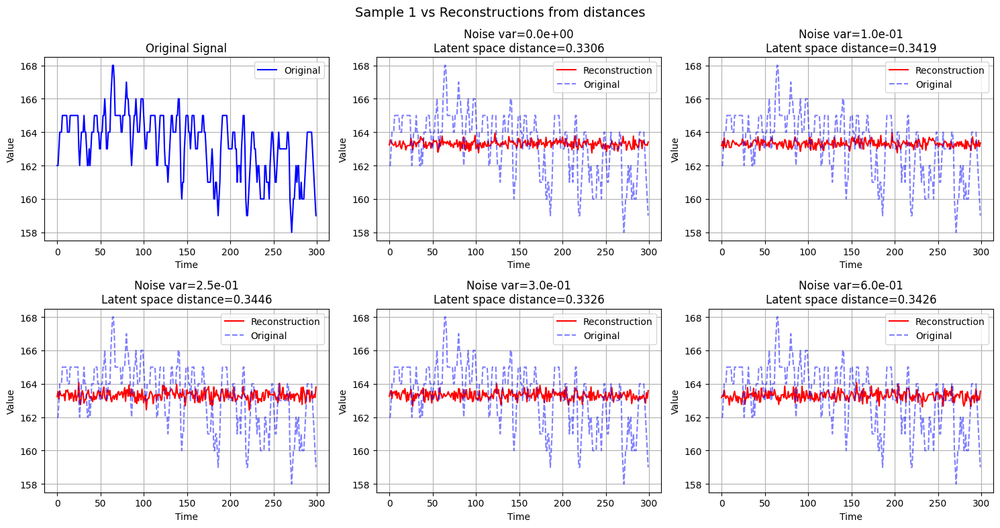

Epoch [1/100]
	Training Loss: 5.656452
	Testing Loss: 5.773672
	Learning Rate: 0.000081000
beta: 0.0
Epoch [11/100]
	Training Loss: 5.654676
	Testing Loss: 5.831738
	Learning Rate: 0.000081000
beta: 0.0
Epoch [21/100]
	Training Loss: 5.650930
	Testing Loss: 5.809266
	Learning Rate: 0.000081000
beta: 0.0
Epoch [31/100]
	Training Loss: 5.646841
	Testing Loss: 5.779266
	Learning Rate: 0.000081000
beta: 0.0
Epoch [41/100]
	Training Loss: 5.652067
	Testing Loss: 5.839291
	Learning Rate: 0.000081000
beta: 0.0
Epoch [51/100]
	Training Loss: 5.648399
	Testing Loss: 5.769277
	Learning Rate: 0.000081000
beta: 0.0
Epoch [61/100]
	Training Loss: 5.654533
	Testing Loss: 5.789841
	Learning Rate: 0.000081000
beta: 0.0
Epoch [71/100]
	Training Loss: 5.650660
	Testing Loss: 5.798373
	Learning Rate: 0.000081000
beta: 0.0
Epoch [81/100]
	Training Loss: 5.645796
	Testing Loss: 5.835831
	Learning Rate: 0.000081000
beta: 0.0
Epoch [91/100]
	Training Loss: 5.656806
	Testing Loss: 5.873144
	Learning Rate: 0.0

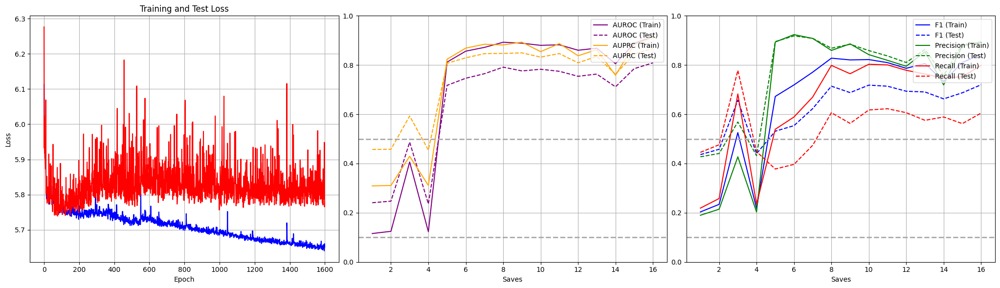

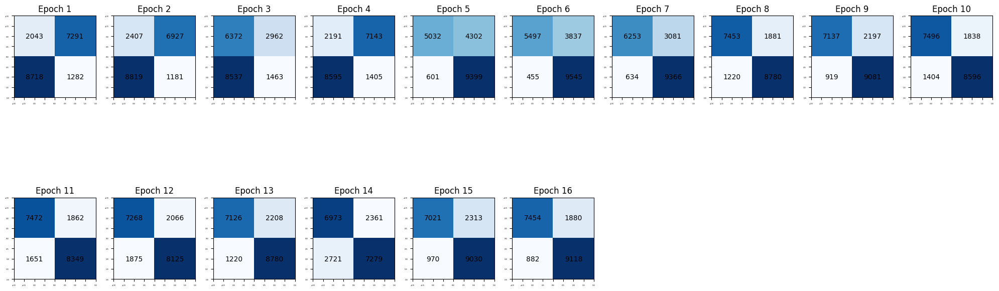

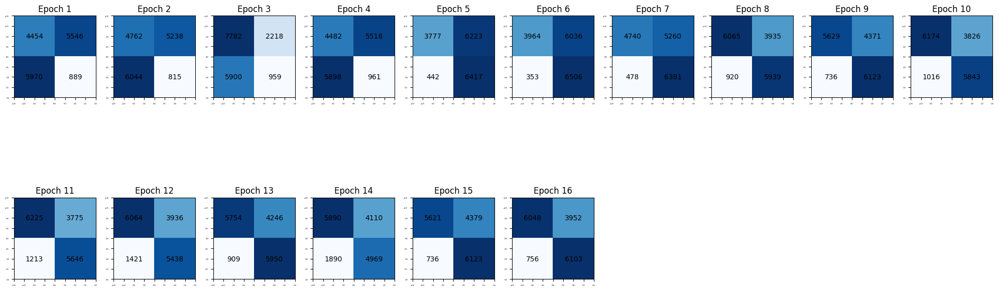

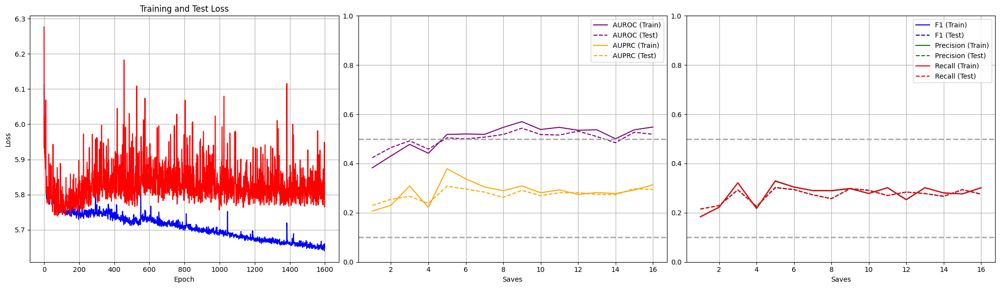

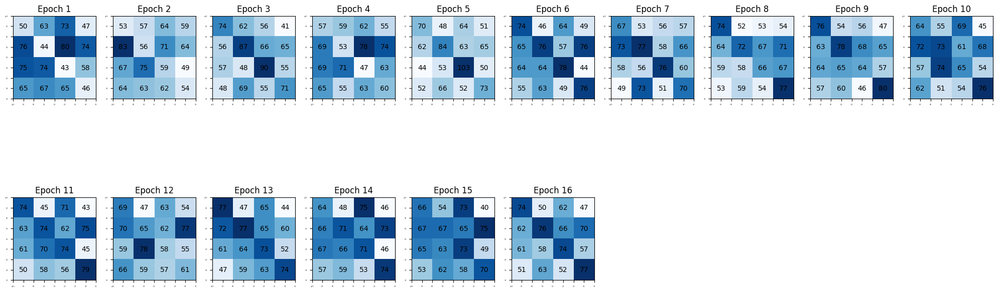

...

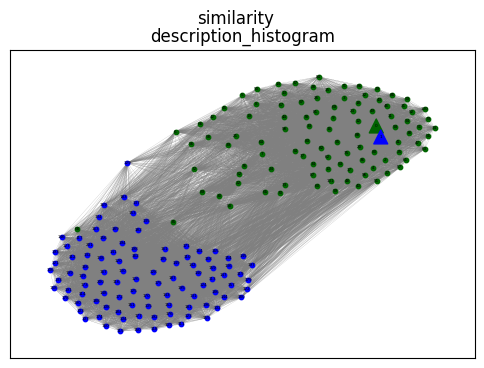

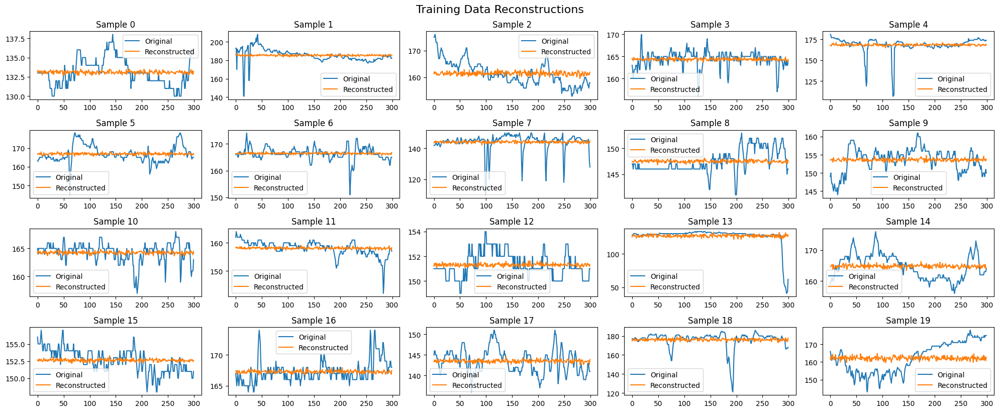

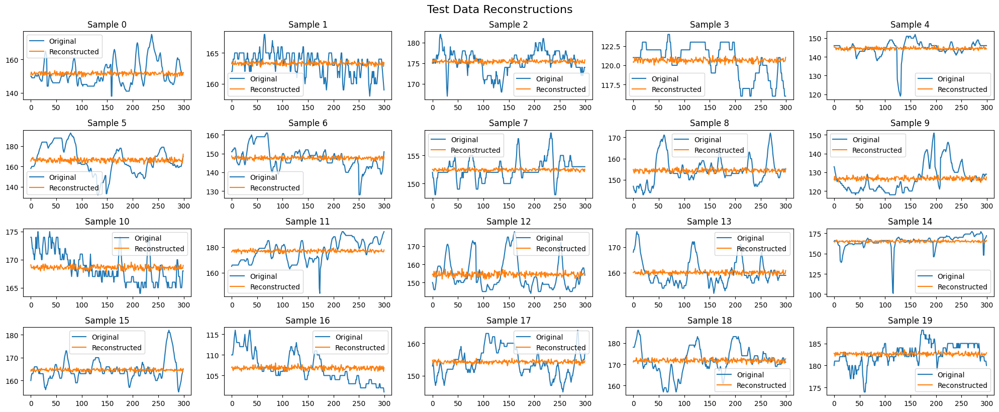

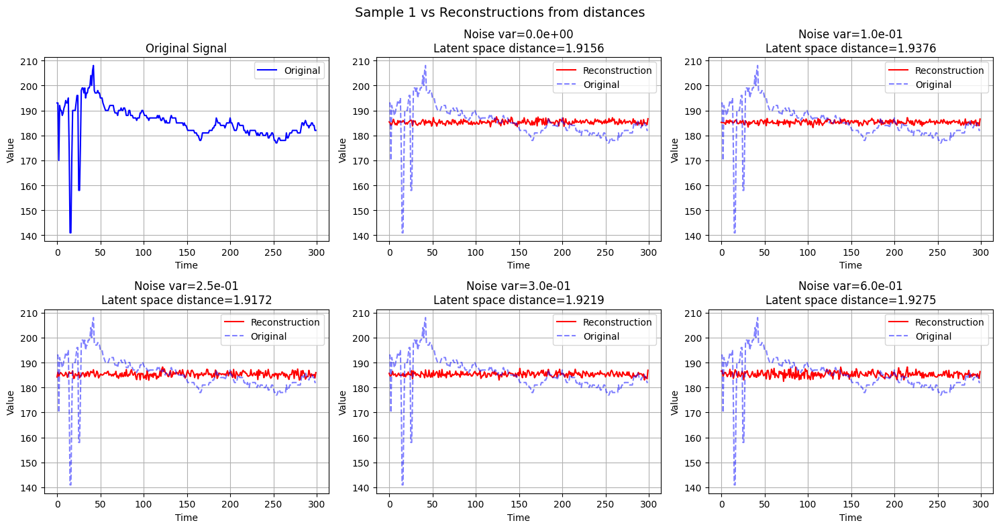

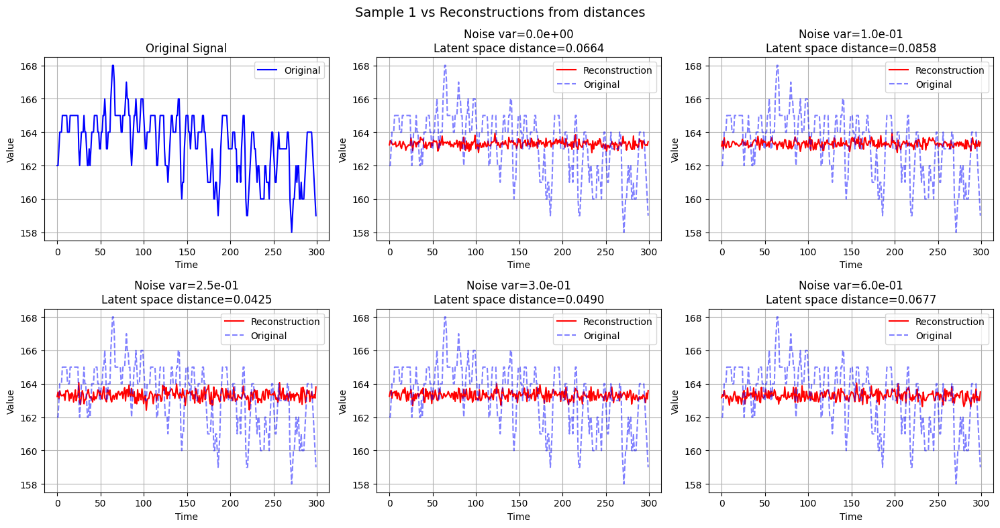

Epoch [1/100]
	Training Loss: 5.646597
	Testing Loss: 5.774598
	Learning Rate: 0.000081000
beta: 0.0


In [ ]:
# overwrite = True
if overwrite or not os.path.exists(model_path):
    
    # ------------------------- ready training for clip -------------------------
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=1e-4,
        weight_decay=1e-4
    )

    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, 
        mode='min',
        factor=0.9,         
        patience=500,      
        verbose=True,
        min_lr=1e-20,        
        threshold=1e-4,      
        cooldown=20          
    )

    kl_annealer = KLAnnealer(start=0.0, 
                                end=0.0, 
                                epochs=10000) # for the first 1000 epochs, favor reconstruction more

    
    for i in range(50):  # config_dict['num_saves']
        train_losses_tmp, test_losses_tmp = train_vital(model, 
                                                        train_dataloader,
                                                        test_dataloader, 
                                                        optimizer, 
                                                        scheduler,
                                                        kl_annealer,
                                                        num_epochs=config_dict['num_epochs']*10, 
                                                        target_type = 'by_target',
                                                        train_type='clip',
                                                        alpha = 1/100)
        train_losses = train_losses + train_losses_tmp
        test_losses = test_losses + test_losses_tmp
        # every num_epochs, evaluate the model
        model.eval()
        if config_dict['3d']:
            train_eval_metrics_ts2txt = eval_clip3d_ts2txt(model, evalclipts2txt_train)
            test_eval_metrics_ts2txt = eval_clip3d_ts2txt(model, evalclipts2txt_test)
            train_eval_metrics_txt2ts = eval_clip3d_txt2ts(model, evalcliptxt2ts_train)
            test_eval_metrics_txt2ts = eval_clip3d_txt2ts(model, evalcliptxt2ts_test)

        else:
            train_eval_metrics_ts2txt = eval_clip_ts2txt(model, evalclipts2txt_train)
            test_eval_metrics_ts2txt = eval_clip_ts2txt(model, evalclipts2txt_test)
            train_eval_metrics_txt2ts = eval_clip_txt2ts(model, evalcliptxt2ts_train)
            test_eval_metrics_txt2ts = eval_clip_txt2ts(model, evalcliptxt2ts_test)

        train_eval_metrics_ts2txt_list.append(train_eval_metrics_ts2txt)
        test_eval_metrics_ts2txt_list.append(test_eval_metrics_ts2txt)
        eval_dict_ts2txt = {'train_losses': train_losses,
                    'test_losses': test_losses,
                    'train_evals': train_eval_metrics_ts2txt_list,
                    'test_evals': test_eval_metrics_ts2txt_list }
        eval_dict_eng = eng_eval_metrics(eval_dict_ts2txt, binary=True, plot=False)
        print("-" * 70)
        print(f"Metric     |  Training  |  Testing")
        print("-" * 70)
        print(f"F1        |   {eval_dict_eng['train_f1'][-1]:.3f}   |   {eval_dict_eng['test_f1'][-1]:.3f}")
        print(f"Precision |   {eval_dict_eng['train_precision'][-1]:.3f}   |   {eval_dict_eng['test_precision'][-1]:.3f}")
        print(f"Recall    |   {eval_dict_eng['train_recall'][-1]:.3f}   |   {eval_dict_eng['test_recall'][-1]:.3f}")
        print(f"AUROC     |   {eval_dict_eng['train_auroc'][-1]:.3f}   |   {eval_dict_eng['test_auroc'][-1]:.3f}")
        print(f"AUPRC     |   {eval_dict_eng['train_auprc'][-1]:.3f}   |   {eval_dict_eng['test_auprc'][-1]:.3f}")
        print("-" * 70)

        train_eval_metrics_txt2ts_list.append(train_eval_metrics_txt2ts)
        test_eval_metrics_txt2ts_list.append(test_eval_metrics_txt2ts)
        eval_dict_txt2ts = {'train_losses': train_losses,
                    'test_losses': test_losses,
                    'train_evals': train_eval_metrics_txt2ts_list,
                    'test_evals': test_eval_metrics_txt2ts_list }
        eval_dict_eng = eng_eval_metrics(eval_dict_txt2ts, binary=False, plot=False)
        print("-" * 70)
        print(f"Metric     |  Training  |  Testing")
        print("-" * 70)
        print(f"F1        |   {eval_dict_eng['train_f1'][-1]:.3f}   |   {eval_dict_eng['test_f1'][-1]:.3f}")
        print(f"Precision |   {eval_dict_eng['train_precision'][-1]:.3f}   |   {eval_dict_eng['test_precision'][-1]:.3f}")
        print(f"Recall    |   {eval_dict_eng['train_recall'][-1]:.3f}   |   {eval_dict_eng['test_recall'][-1]:.3f}")
        print(f"AUROC     |   {eval_dict_eng['train_auroc'][-1]:.3f}   |   {eval_dict_eng['test_auroc'][-1]:.3f}")
        print(f"AUPRC     |   {eval_dict_eng['train_auprc'][-1]:.3f}   |   {eval_dict_eng['test_auprc'][-1]:.3f}")
        print("-" * 70)

        # save model and losses
        torch.save(model.state_dict(), model_path)
        torch.save(eval_dict_ts2txt, output_dir+'/evals_clip_ts2txt.pth')
        torch.save(eval_dict_txt2ts, output_dir+'/evals_clip_txt2ts.pth')
    
        # print results 
        eval_dict_eng = eng_eval_metrics(eval_dict_ts2txt, binary=True, plot=True, plot_confusion_matrices=True)
        eval_dict_eng = eng_eval_metrics(eval_dict_txt2ts, binary=False, plot=True, plot_confusion_matrices=True)
        _, _ = net_emb(df_train, model, config_dict,
                       top=100,
                       y_col = 'description_succ_inc',
                       text_levels = ['High amount of consecutive increases.', 'Low amount of consecutive increases.'] )
        _, _ = net_emb(df_train, model, config_dict,
                       top=100,
                       y_col = 'description_succ_unc',
                       text_levels = ['Many flat lines.', 'Few flat lines.'] )
        _, _ = net_emb(df_train, model, config_dict,
                       top=100,
                       y_col = 'description_histogram',
                       text_levels = ['High variability.', 'Low variability.'] )
        
        # eval vae
        plot_reconstructions(model, 
                            df=df_train, 
                            config_dict = config_dict, 
                            text_col_ls = config_dict['text_col_ls'],
                            title="Training Data Reconstructions")

        plot_reconstructions(model, 
                            df=df_test, 
                            config_dict = config_dict, 
                            text_col_ls = config_dict['text_col_ls'],
                            title="Test Data Reconstructions")
        distances = [0, 0.1, 0.25, 0.3, 0.6]
        plot_reconstruction_from_distances(model, df_train, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
        plot_reconstruction_from_distances(model, df_test, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
    
        
else:
    model.load_state_dict(torch.load(model_path, map_location=torch.device(device)))
    model.eval()
    
    # eval clip
    eval_dict_ts2txt = torch.load(output_dir+'/evals_clip_ts2txt.pth', map_location=torch.device(device))
    eval_dict_txt2ts = torch.load(output_dir+'/evals_clip_txt2ts.pth', map_location=torch.device(device))
    eval_dict_eng = eng_eval_metrics(eval_dict_ts2txt, binary=True, plot=True, plot_confusion_matrices=True)
    eval_dict_eng = eng_eval_metrics(eval_dict_txt2ts, binary=False, plot=True, plot_confusion_matrices=True)
    pairwise_distances, ts2tx_distances = net_emb(df_train, model, config_dict, 
                                                  top=100,
                                                  y_col = 'description_succ_inc',
                                                  text_levels = ['High amount of consecutive increases.', 'Low amount of consecutive increases.'] )
    
    # eval vae
    plot_reconstructions(model, 
                        df=df_train, 
                        config_dict = config_dict, 
                        text_col_ls = config_dict['text_col_ls'],
                        title="Training Data Reconstructions")

    plot_reconstructions(model, 
                        df=df_test, 
                        config_dict = config_dict, 
                        text_col_ls = config_dict['text_col_ls'],
                        title="Test Data Reconstructions")
    distances = [0, 0.1, 0.25, 0.3, 0.6]
    plot_reconstruction_from_distances(model, df_train, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
    plot_reconstruction_from_distances(model, df_test, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
    

In [ ]:
pairwise_distances, ts2tx_distances = net_emb(df_train, model, config_dict)
# eval vae
plot_reconstructions(model, 
                    df=df_train, 
                    config_dict = config_dict, 
                    text_col_ls = config_dict['text_col_ls'],
                    title="Training Data Reconstructions")

plot_reconstructions(model, 
                    df=df_test, 
                    config_dict = config_dict, 
                    text_col_ls = config_dict['text_col_ls'],
                    title="Test Data Reconstructions")
distances = [0, 0.1, 0.25, 0.3, 0.6]
plot_reconstruction_from_distances(model, df_train, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
plot_reconstruction_from_distances(model, df_test, config_dict, text_col_ls = config_dict['text_col_ls'], distances = distances)
    

In [ ]:
pairwise_distances, ts2tx_distances = net_emb(df_train, model, config_dict)
for i in range(95, 105):
    print(ts2tx_distances['simi']['High amount of consecutive increases.'][i])
    print(ts2tx_distances['simi']['Low amount of consecutive increases.'][i])
    
for i in range(95, 105):
    print(ts2tx_distances['l2']['High amount of consecutive increases.'][i])
    print(ts2tx_distances['l2']['Low amount of consecutive increases.'][i])

# Generation process

In [ ]:
df_train_high = df_train[df_train['text'] == 'High amount of consecutive increases.'].reset_index(drop=True)
df_train_low = df_train[df_train['text'] == 'Low amount of consecutive increases.'].reset_index(drop=True)
df_test_high = df_test[df_test['text'] == 'High amount of consecutive increases.'].reset_index(drop=True)
df_test_low = df_test[df_test['text'] == 'Low amount of consecutive increases.'].reset_index(drop=True)

In [ ]:
tid = 4
df = df_train_low.iloc[[tid]].copy()
print(df['text'])

df['text1'] = 'Low amount of consecutive increases.'
df['text2'] = 'High amount of consecutive increases.'

text_cols = ['text1', 'text2']
w_values = np.arange(0.4, 1.2, 0.2)
w_values = np.concatenate([[0], w_values])
plot_interpolate_ts_tx_ws(df, model, config_dict, text_cols, w_values = w_values, label = True)